In [1]:
# Import libraries

import glob
import numpy as np
import matplotlib.pyplot as plt
import cmocean
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import xarray as xr
import xskillscore as xs
import hvplot.xarray
import dask
from dask.distributed import Client

In [2]:
# Open dask client

client = Client()
client

2022-07-15 11:09:51,522 - distributed.diskutils - INFO - Found stale lock file and directory '/home/anthony/Drive/Thesis/sandbox/dask-worker-space/worker-xgbp2yo2', purging
2022-07-15 11:09:51,522 - distributed.diskutils - INFO - Found stale lock file and directory '/home/anthony/Drive/Thesis/sandbox/dask-worker-space/worker-ph8as1aj', purging
2022-07-15 11:09:51,523 - distributed.diskutils - INFO - Found stale lock file and directory '/home/anthony/Drive/Thesis/sandbox/dask-worker-space/worker-d7x8bk5e', purging
2022-07-15 11:09:51,523 - distributed.diskutils - INFO - Found stale lock file and directory '/home/anthony/Drive/Thesis/sandbox/dask-worker-space/worker-b41nmm7d', purging


Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:8787/status,
Dashboard: http://127.0.0.1:8787/status,Workers: 4
Total threads: 12,Total memory: 15.48 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:34735,Workers: 4
Dashboard: http://127.0.0.1:8787/status,Total threads: 12
Started: Just now,Total memory: 15.48 GiB
Comm: tcp://127.0.0.1:41273,Total threads: 3
Dashboard: http://127.0.0.1:45805/status,Memory: 3.87 GiB
Nanny: tcp://127.0.0.1:43461,


In [3]:
ws_ds = xr.open_dataset("../data_raw/era5slvmonthhour-costa/ws_10m", 
                           chunks = {'time': '500MB'},
                           engine = "cfgrib")

In [7]:
ws_ds

<xarray.Dataset>
Dimensions:     (time: 4608, latitude: 41, longitude: 41)
Coordinates:
    number      int64 ...
  * time        (time) datetime64[ns] 1990-01-01 ... 2005-12-01T23:00:00
    step        timedelta64[ns] ...
    surface     float64 ...
  * latitude    (latitude) float64 17.0 16.75 16.5 16.25 ... 7.75 7.5 7.25 7.0
  * longitude   (longitude) float64 -91.0 -90.75 -90.5 ... -81.5 -81.25 -81.0
    valid_time  (time) datetime64[ns] dask.array<chunksize=(4608,), meta=np.ndarray>
Data variables:
    si10        (time, latitude, longitude) float32 dask.array<chunksize=(4608, 41, 41), meta=np.ndarray>
Attributes:
    GRIB_edition:            1
    GRIB_centre:             ecmf
    GRIB_centreDescription:  European Centre for Medium-Range Weather Forecasts
    GRIB_subCentre:          0
    Conventions:             CF-1.7
    institution:             European Centre for Medium-Range Weather Forecasts
    history:                 2022-07-15T10:49 GRIB to CDM+CF via cfgrib-0.9.1...

In [4]:
ws_da = ws_ds["si10"]

In [7]:
ws_da

<xarray.DataArray 'si10' (time: 4608, latitude: 41, longitude: 41)>
dask.array<open_dataset-a541cbfa23548abfed9726019b7b55d8si10, shape=(4608, 41, 41), dtype=float32, chunksize=(4608, 41, 41), chunktype=numpy.ndarray>
Coordinates:
    number      int64 ...
  * time        (time) datetime64[ns] 1990-01-01 ... 2005-12-01T23:00:00
    step        timedelta64[ns] ...
    surface     float64 ...
  * latitude    (latitude) float64 17.0 16.75 16.5 16.25 ... 7.75 7.5 7.25 7.0
  * longitude   (longitude) float64 -91.0 -90.75 -90.5 ... -81.5 -81.25 -81.0
    valid_time  (time) datetime64[ns] dask.array<chunksize=(4608,), meta=np.ndarray>
Attributes:
    GRIB_paramId:                             207
    GRIB_dataType:                            an
    GRIB_numberOfPoints:                      1681
    GRIB_typeOfLevel:                         surface
    GRIB_stepUnits:                           1
    GRIB_stepType:                            avgua
    GRIB_gridType:                            regular_ll
    GRIB_NV:                                  0
    GRIB_Nx:                                  41
    GRIB_Ny:                                  41
    GRIB_cfName:                              unknown
    GRIB_cfVarName:                           si10
    GRIB_gridDefinitionDescription:           Latitude/Longitude Grid
    GRIB_iDirectionIncrementInDegrees:        0.25
    GRIB_iScansNegatively:                    0
    GRIB_jDirectionIncrementInDegrees:        0.25
    GRIB_jPointsAreConsecutive:               0
    GRIB_jScansPositively:                    0
    GRIB_latitudeOfFirstGridPointInDegrees:   17.0
    GRIB_latitudeOfLastGridPointInDegrees:    7.0
    GRIB_longitudeOfFirstGridPointInDegrees:  -91.0
    GRIB_longitudeOfLastGridPointInDegrees:   -81.0
    GRIB_missingValue:                        9999
    GRIB_name:                                10 metre wind speed
    GRIB_shortName:                           10si
    GRIB_totalNumber:                         0
    GRIB_units:                               m s**-1
    long_name:                                10 metre wind speed
    units:                                    m s**-1
    standard_name:                            unknown

In [8]:
ws_da.time.data

array(['1990-01-01T00:00:00.000000000', '1990-01-01T01:00:00.000000000',
       '1990-01-01T02:00:00.000000000', ...,
       '2005-12-01T21:00:00.000000000', '2005-12-01T22:00:00.000000000',
       '2005-12-01T23:00:00.000000000'], dtype='datetime64[ns]')

In [9]:
(
    ws_da.coarsen(time=24)
    .construct(time=("yearmonth", "hour"))
    .coarsen(yearmonth=12)
    .construct(yearmonth = ("year", "month"))
    
    # .groupby(("yearmonth", "hour"))
    # .min()
    
    .reduce(np.min, dim = "hour")
    
    # .coarsen(yearmonth=12)
    # .construct(yearmonth = ("year", "month"))
    
    # .groupby("hour")
    # .min()
    #.groupby("time.hour")
    #.min()
)

<xarray.DataArray 'si10' (year: 16, month: 12, latitude: 41, longitude: 41)>
dask.array<amin-aggregate, shape=(16, 12, 41, 41), dtype=float32, chunksize=(16, 12, 41, 41), chunktype=numpy.ndarray>
Coordinates:
    number     int64 ...
    step       timedelta64[ns] ...
    surface    float64 ...
  * latitude   (latitude) float64 17.0 16.75 16.5 16.25 ... 7.75 7.5 7.25 7.0
  * longitude  (longitude) float64 -91.0 -90.75 -90.5 ... -81.5 -81.25 -81.0
Dimensions without coordinates: year, month

In [11]:
ws_da.resample({"time": "1M"}).min()

<xarray.DataArray 'si10' (time: 192, latitude: 41, longitude: 41)>
dask.array<stack, shape=(192, 41, 41), dtype=float32, chunksize=(1, 41, 41), chunktype=numpy.ndarray>
Coordinates:
  * time       (time) datetime64[ns] 1990-01-31 1990-02-28 ... 2005-12-31
    number     int64 ...
    step       timedelta64[ns] ...
    surface    float64 ...
  * latitude   (latitude) float64 17.0 16.75 16.5 16.25 ... 7.75 7.5 7.25 7.0
  * longitude  (longitude) float64 -91.0 -90.75 -90.5 ... -81.5 -81.25 -81.0

In [12]:
(
    ws_da
    .coarsen(time=24)
    .construct(time=("yearmonth", "hour"))
    .coarsen(yearmonth=12)
    .construct(yearmonth = ("year", "month"))
    .argmin(dim = "hour")
    .compute()
    # .reduce(np.argmin, dim = "hour")
    # .compute()
    # .idxmin(dim = "hour")
)

<xarray.DataArray 'si10' (year: 16, month: 12, latitude: 41, longitude: 41)>
array([[[[14, 14, 23, ..., 22, 22, 22],
         [14, 14, 12, ..., 22, 22, 22],
         [14, 14, 14, ..., 22, 22, 22],
         ...,
         [10, 10, 10, ..., 18,  3,  3],
         [10, 10, 10, ..., 18, 18, 18],
         [10, 10, 10, ..., 19, 19, 18]],

        [[12,  0,  0, ..., 22, 22, 22],
         [12, 13, 12, ..., 22, 22, 22],
         [14, 13, 13, ..., 22, 22, 22],
         ...,
         [10, 10, 10, ..., 18, 18,  6],
         [10, 10, 10, ..., 19, 19, 17],
         [10, 10, 10, ..., 19, 19, 18]],

        [[ 0,  0,  0, ..., 10, 10, 10],
         [12, 12, 12, ..., 10, 10, 10],
         [14, 13, 12, ..., 10, 10, 10],
         ...,
...
         ...,
         [16, 15, 15, ..., 13, 13,  5],
         [16, 16,  3, ..., 17,  5,  5],
         [16,  3,  3, ..., 17, 17, 17]],

        [[12, 23, 23, ..., 22, 22, 22],
         [14, 23, 23, ..., 22, 22, 22],
         [14, 14, 23, ..., 22, 22, 22],
         ...,
         [ 3,  2,  2, ..., 14, 14, 14],
         [ 3,  3,  3, ..., 14, 14, 14],
         [ 4,  3,  3, ..., 15, 15, 15]],

        [[ 9, 23, 23, ..., 22, 22, 22],
         [ 0, 23, 23, ..., 22, 22, 22],
         [14, 23, 23, ..., 22, 22, 22],
         ...,
         [10, 13, 13, ..., 17, 15,  2],
         [13, 14, 13, ..., 17, 17,  2],
         [14, 14, 13, ..., 17, 17,  2]]]])
Coordinates:
    number     int64 0
    step       timedelta64[ns] 00:00:00
    surface    float64 0.0
  * latitude   (latitude) float64 17.0 16.75 16.5 16.25 ... 7.75 7.5 7.25 7.0
  * longitude  (longitude) float64 -91.0 -90.75 -90.5 ... -81.5 -81.25 -81.0
Dimensions without coordinates: year, month

In [5]:
ws_da_argmax = (
    ws_da
    .coarsen(time=24)
    .construct(time=("yearmonth", "hour"))
    .coarsen(yearmonth=12)
    .construct(yearmonth = ("year", "month"))
    .argmax(dim = "hour")
)

In [16]:
ws_da_argmax

<xarray.DataArray 'si10' (year: 16, month: 12, latitude: 41, longitude: 41)>
dask.array<nanarg_agg-aggregate, shape=(16, 12, 41, 41), dtype=int64, chunksize=(16, 12, 41, 41), chunktype=numpy.ndarray>
Coordinates:
    number     int64 ...
    step       timedelta64[ns] ...
    surface    float64 ...
  * latitude   (latitude) float64 17.0 16.75 16.5 16.25 ... 7.75 7.5 7.25 7.0
  * longitude  (longitude) float64 -91.0 -90.75 -90.5 ... -81.5 -81.25 -81.0
Dimensions without coordinates: year, month

In [15]:
np.cos(ws_da_argmax /12 * 2 * np.pi)

<xarray.DataArray 'si10' (year: 16, month: 12, latitude: 41, longitude: 41)>
dask.array<cos, shape=(16, 12, 41, 41), dtype=float64, chunksize=(16, 12, 41, 41), chunktype=numpy.ndarray>
Coordinates:
    number     int64 ...
    step       timedelta64[ns] ...
    surface    float64 ...
  * latitude   (latitude) float64 17.0 16.75 16.5 16.25 ... 7.75 7.5 7.25 7.0
  * longitude  (longitude) float64 -91.0 -90.75 -90.5 ... -81.5 -81.25 -81.0
Dimensions without coordinates: year, month

In [6]:
ws_da_umax = (
    ws_da
    .coarsen(time=24)
    .construct(time=("yearmonth", "hour"))
    .coarsen(yearmonth=12)
    .construct(yearmonth = ("year", "month"))
    .max(dim = "hour")
    *np.cos(ws_da_argmax/12*2*np.pi)
)

In [22]:
ws_da_umax.compute()

<xarray.DataArray 'si10' (year: 16, month: 12, latitude: 41, longitude: 41)>
array([[[[-2.08891166e+00, -1.84703347e+00, -1.64490449e+00, ...,
          -4.09077644e+00, -4.14253426e+00,  2.56835252e-15],
         [-1.78550676e+00, -1.55398874e+00, -1.38611174e+00, ...,
           2.53419337e-15, -4.17207527e+00,  2.58801086e-15],
         [-1.32289358e+00, -1.17171971e+00, -1.38091052e+00, ...,
           2.55370221e-15,  2.59810163e-15,  2.62605683e-15],
         ...,
         [-5.19527035e+00, -5.07306267e+00, -5.74287987e+00, ...,
          -1.73959255e-15, -1.80290284e-15, -2.26692414e+00],
         [ 2.71542811e+00,  2.60532069e+00,  2.46823573e+00, ...,
           3.77156832e+00,  4.17287489e+00,  2.10215902e+00],
         [ 2.44369960e+00,  2.31479335e+00,  2.19479823e+00, ...,
           4.04917851e+00,  4.14792592e+00,  2.05845785e+00]],

        [[-2.88460732e+00, -2.82357216e+00, -2.65072060e+00, ...,
           2.15397540e-15, -6.12971341e+00, -6.25297826e+00],
         [-1.26699591e+00, -2.09366227e+00, -2.00570656e+00, ...,
           2.17423170e-15,  2.16077733e-15, -6.17199981e+00],
         [-9.42777157e-01, -9.56693172e-01, -1.99774575e+00, ...,
           2.16227226e-15,  2.18335078e-15,  2.19261934e-15],
...
         [ 2.50111556e+00, -4.34796907e+00, -2.54834104e+00, ...,
          -2.61160803e+00, -2.24246740e+00, -3.41537067e+00],
         [ 2.60817122e+00,  2.60963607e+00, -9.48578131e-16, ...,
          -2.40124275e-15, -2.60367346e+00, -4.45667319e+00],
         [ 2.70561814e+00,  2.70903611e+00, -2.33761852e-15, ...,
          -2.43954286e-15, -2.40103346e-15, -2.38502275e-15]],

        [[-9.01589585e-16,  6.35598908e-16,  1.05388391e+00, ...,
           3.48344922e+00,  3.51079297e+00,  3.54582715e+00],
         [-8.05316031e-16, -7.41691803e-16,  9.14235473e-01, ...,
           3.52092481e+00,  3.52300000e+00,  3.54106641e+00],
         [-7.25319862e-01, -6.25640373e-16,  7.34425902e-01, ...,
           3.52934766e+00,  3.57280469e+00,  3.56767774e+00],
         ...,
         [-3.67267761e+00,  2.59603910e-16,  2.58034233e-16, ...,
           1.81915045e+00, -1.33544822e-15, -2.62799714e+00],
         [-3.62235680e+00, -3.62214537e+00,  2.56135672e-16, ...,
           1.93768072e+00, -1.54013406e-15, -1.80222416e+00],
         [ 3.70001304e+00,  3.71819620e+00,  3.72496202e+00, ...,
           1.90423346e+00, -1.57152759e-15, -1.50382221e-15]]]])
Coordinates:
    number     int64 0
    step       timedelta64[ns] 00:00:00
    surface    float64 0.0
  * latitude   (latitude) float64 17.0 16.75 16.5 16.25 ... 7.75 7.5 7.25 7.0
  * longitude  (longitude) float64 -91.0 -90.75 -90.5 ... -81.5 -81.25 -81.0
Dimensions without coordinates: year, month

In [7]:
ws_da_vmax = (
    ws_da
    .coarsen(time=24)
    .construct(time=("yearmonth", "hour"))
    .coarsen(yearmonth=12)
    .construct(yearmonth = ("year", "month"))
    .max(dim = "hour")
    *np.sin(ws_da_argmax/12*2*np.pi)
)

In [25]:
ws_da_vmax.compute()

<xarray.DataArray 'si10' (year: 16, month: 12, latitude: 41, longitude: 41)>
array([[[[-1.20603371e+00, -1.06638527e+00, -9.49686050e-01, ...,
           7.08543264e+00,  7.17507980e+00,  8.38887596e+00],
         [-1.03086281e+00, -8.97195816e-01, -8.00271988e-01, ...,
           8.27730370e+00,  7.22624634e+00,  8.45308495e+00],
         [-7.63772964e-01, -6.76492691e-01,  1.69112764e-16, ...,
           8.34102440e+00,  8.48604393e+00,  8.57735252e+00],
         ...,
         [-2.99949074e+00, -2.92893410e+00,  2.10989983e-15, ...,
          -4.05852890e+00, -4.20623398e+00,  3.92642779e+00],
         [ 4.70325946e+00,  4.51254781e+00,  4.27510969e+00, ...,
           2.17751598e+00, -2.40921044e+00, -3.64104623e+00],
         [ 4.23261186e+00,  4.00933969e+00,  3.80150205e+00, ...,
           2.33779430e+00, -2.39480615e+00, -3.56535358e+00]],

        [[ 1.05978753e-15,  1.03736358e-15,  9.73858948e-16, ...,
           7.03541756e+00,  3.53899169e+00,  3.61015868e+00],
         [-2.19450128e+00, -1.20877647e+00, -1.15799522e+00, ...,
           7.10157967e+00,  7.05763435e+00,  3.56340575e+00],
         [-1.63293794e+00, -1.65704118e+00,  2.44653294e-16, ...,
           7.06251717e+00,  7.13136482e+00,  7.16163826e+00],
...
         [ 4.33205923e+00, -2.51030111e+00, -4.41385615e+00, ...,
          -4.52343779e+00, -3.88406748e+00, -1.97186518e+00],
         [ 4.51748508e+00,  4.52002226e+00, -5.16381884e+00, ...,
          -5.60218143e+00, -4.50969472e+00, -2.57306147e+00],
         [-4.68626809e+00, -4.69218819e+00, -5.45374393e+00, ...,
          -5.69153690e+00, -5.60169315e+00, -5.56433964e+00]],

        [[-2.10343933e+00,  2.07602358e+00,  1.82538048e+00, ...,
           6.03351104e+00,  6.08087180e+00,  6.14155278e+00],
         [-1.87882984e+00, -1.73039234e+00,  1.58350229e+00, ...,
           6.09842065e+00,  6.10201500e+00,  6.13330693e+00],
         [-1.25629085e+00, -1.45964038e+00,  1.27206298e+00, ...,
           6.11300946e+00,  6.18827925e+00,  6.17939910e+00],
         ...,
         [ 2.12042141e+00,  4.23965359e+00,  4.21401882e+00, ...,
          -3.15086100e+00, -3.11564636e+00, -1.51727486e+00],
         [ 2.09136868e+00,  2.09124660e+00,  4.18301296e+00, ...,
          -3.35616146e+00, -3.59318542e+00, -3.12154381e+00],
         [ 2.13620353e+00,  2.14670157e+00,  2.15060782e+00, ...,
          -3.29822909e+00, -3.66642761e+00, -3.50846863e+00]]]])
Coordinates:
    number     int64 0
    step       timedelta64[ns] 00:00:00
    surface    float64 0.0
  * latitude   (latitude) float64 17.0 16.75 16.5 16.25 ... 7.75 7.5 7.25 7.0
  * longitude  (longitude) float64 -91.0 -90.75 -90.5 ... -81.5 -81.25 -81.0
Dimensions without coordinates: year, month

In [8]:
wsmax_ds = xr.Dataset(
    data_vars = {"umax": ws_da_umax,
                "vmax": ws_da_vmax}
)

In [28]:
wsmax_ds

<xarray.Dataset>
Dimensions:    (latitude: 41, longitude: 41, year: 16, month: 12)
Coordinates:
    number     int64 0
    step       timedelta64[ns] 00:00:00
    surface    float64 0.0
  * latitude   (latitude) float64 17.0 16.75 16.5 16.25 ... 7.75 7.5 7.25 7.0
  * longitude  (longitude) float64 -91.0 -90.75 -90.5 ... -81.5 -81.25 -81.0
Dimensions without coordinates: year, month
Data variables:
    umax       (year, month, latitude, longitude) float64 dask.array<chunksize=(16, 12, 41, 41), meta=np.ndarray>
    vmax       (year, month, latitude, longitude) float64 dask.array<chunksize=(16, 12, 41, 41), meta=np.ndarray>

In [31]:
wsmax_ds.isel(year = 0, month = 0)

<xarray.Dataset>
Dimensions:    (latitude: 41, longitude: 41)
Coordinates:
    number     int64 0
    step       timedelta64[ns] 00:00:00
    surface    float64 0.0
  * latitude   (latitude) float64 17.0 16.75 16.5 16.25 ... 7.75 7.5 7.25 7.0
  * longitude  (longitude) float64 -91.0 -90.75 -90.5 ... -81.5 -81.25 -81.0
Data variables:
    umax       (latitude, longitude) float64 dask.array<chunksize=(41, 41), meta=np.ndarray>
    vmax       (latitude, longitude) float64 dask.array<chunksize=(41, 41), meta=np.ndarray>

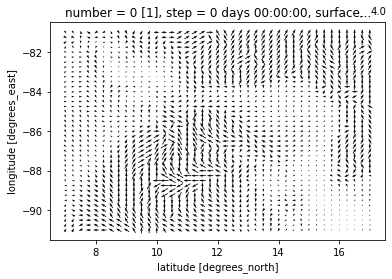

In [24]:
wsmax_ds.isel(year = 0, month = 0).plot.quiver(x = "latitude", y = "longitude", u = "umax", v = "vmax")

In [40]:
wsmax_ds.to_netcdf("./sandbox_output/wsmax.nc")

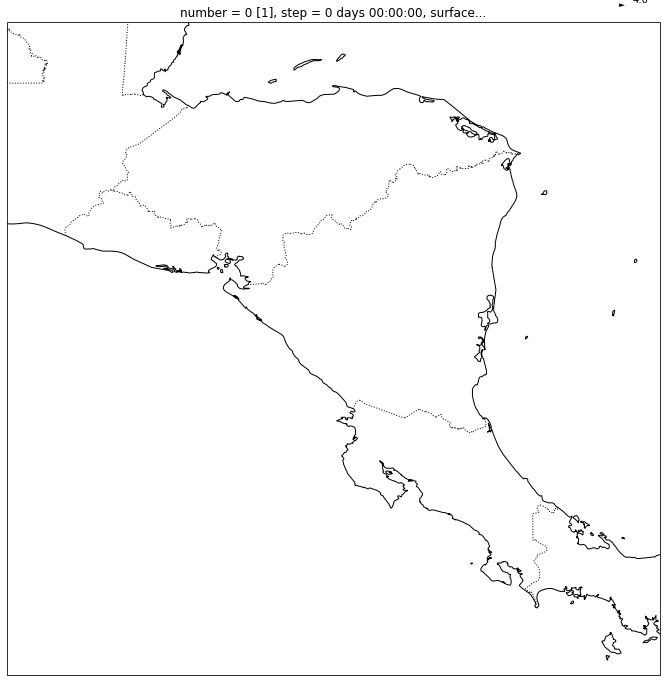

In [31]:
fig = plt.figure(figsize=[12, 12])
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())
ax.set_extent([-91, -81, 7, 17], crs=ccrs.PlateCarree())
wsmax_ds.isel(year = 0, month = 0).plot.quiver(ax = ax, x = "latitude", y = "longitude", u = "umax", v = "vmax")
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS, linestyle=':')

plt.show()

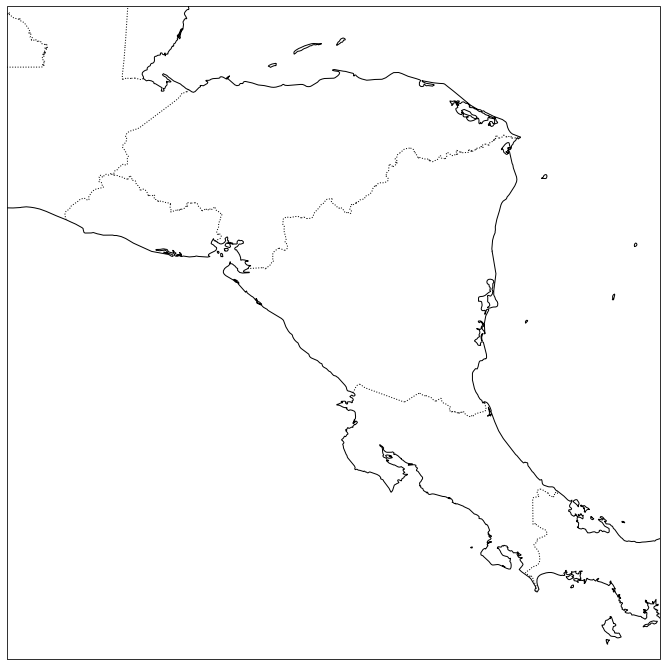

In [30]:
fig = plt.figure(figsize=[12, 12])
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())
ax.set_extent([-91, -81, 7, 17], crs=ccrs.PlateCarree())
# wsmax_ds.isel(year = 0, month = 0).plot.quiver(ax = ax, x = "latitude", y = "longitude", u = "umax", v = "vmax")
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.quiver(x = wsmax_ds.isel(year = 0, month = 0)["latitude"],
         y = wsmax_ds.isel(year = 0, month = 0)["longitude"],
         u = wsmax_ds.isel(year = 0, month = 0)["umax"],
         v = wsmax_ds.isel(year = 0, month = 0)["vmax"])
plt.show()

In [34]:
wsmax_ds.isel(year = 0, month = 0)

<xarray.Dataset>
Dimensions:    (latitude: 41, longitude: 41)
Coordinates:
    number     int64 0
    step       timedelta64[ns] 00:00:00
    surface    float64 0.0
  * latitude   (latitude) float64 17.0 16.75 16.5 16.25 ... 7.75 7.5 7.25 7.0
  * longitude  (longitude) float64 -91.0 -90.75 -90.5 ... -81.5 -81.25 -81.0
Data variables:
    umax       (latitude, longitude) float64 dask.array<chunksize=(41, 41), meta=np.ndarray>
    vmax       (latitude, longitude) float64 dask.array<chunksize=(41, 41), meta=np.ndarray>

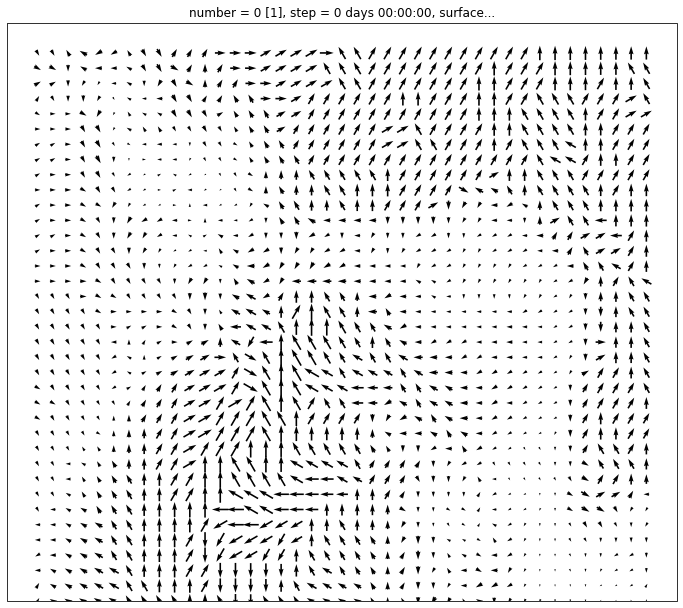

In [33]:
fig = plt.figure(figsize=[12, 12])
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())
wsmax_ds.isel(year = 0, month = 0).plot.quiver(ax = ax, x = "latitude", y = "longitude", u = "umax", v = "vmax", transform=ccrs.PlateCarree())
ax.coastlines()
plt.show()

In [9]:
# Import libraries

import glob
import numpy as np
import matplotlib.pyplot as plt
import cmocean
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import xarray as xr
import xskillscore as xs
import hvplot.xarray
import metpy.calc as mpcalc
import metpy.plots as mpplots
from matplotlib.patheffects import withStroke
from metpy.io import parse_metar_file
from metpy.units import pandas_dataframe_to_unit_arrays
from siphon.catalog import TDSCatalog
import dask
from dask.distributed import Client

In [13]:
# Open dask client

client = Client()
client

/home/anthony/anaconda3/envs/thesis/lib/python3.10/site-packages/distributed/node.py:180: UserWarning: Port 8787 is already in use.
Perhaps you already have a cluster running?
Hosting the HTTP server on port 34583 instead
  warnings.warn(


Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:34583/status,
Dashboard: http://127.0.0.1:34583/status,Workers: 4
Total threads: 12,Total memory: 15.48 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:43535,Workers: 4
Dashboard: http://127.0.0.1:34583/status,Total threads: 12
Started: Just now,Total memory: 15.48 GiB
Comm: tcp://127.0.0.1:44991,Total threads: 3
Dashboard: http://127.0.0.1:38067/status,Memory: 3.87 GiB
Nanny: tcp://127.0.0.1:42289,


In [82]:
ws_ds = xr.open_dataset("../data_raw/era5slvmonthhour-costa/ws_10m", 
                           chunks = {'time': '500MB'},
                           engine = "cfgrib")

In [83]:
ws_da = ws_ds["si10"]

In [84]:
ws_da_argmax = (
    ws_da
    .coarsen(time=24)
    .construct(time=("yearmonth", "hour"))
    .coarsen(yearmonth=12)
    .construct(yearmonth = ("year", "month"))
    .argmax(dim = "hour")
)

In [85]:
ws_da_umax = (
    ws_da
    .coarsen(time=24)
    .construct(time=("yearmonth", "hour"))
    .coarsen(yearmonth=12)
    .construct(yearmonth = ("year", "month"))
    .max(dim = "hour")
    *np.sin(ws_da_argmax/24*2*np.pi)
)

In [86]:
ws_da_vmax = (
    ws_da
    .coarsen(time=24)
    .construct(time=("yearmonth", "hour"))
    .coarsen(yearmonth=12)
    .construct(yearmonth = ("year", "month"))
    .max(dim = "hour")
    *np.cos(ws_da_argmax/24*2*np.pi)
)

In [87]:
wsmax_ds = xr.Dataset(
    data_vars = {"umax": ws_da_umax,
                "vmax": ws_da_vmax}
)

In [88]:
wsmax_ds

<xarray.Dataset>
Dimensions:    (latitude: 41, longitude: 41, year: 16, month: 12)
Coordinates:
    number     int64 0
    step       timedelta64[ns] 00:00:00
    surface    float64 0.0
  * latitude   (latitude) float64 17.0 16.75 16.5 16.25 ... 7.75 7.5 7.25 7.0
  * longitude  (longitude) float64 -91.0 -90.75 -90.5 ... -81.5 -81.25 -81.0
Dimensions without coordinates: year, month
Data variables:
    umax       (year, month, latitude, longitude) float64 dask.array<chunksize=(16, 12, 41, 41), meta=np.ndarray>
    vmax       (year, month, latitude, longitude) float64 dask.array<chunksize=(16, 12, 41, 41), meta=np.ndarray>

In [44]:
wsmax_ds_time0 = wsmax_ds.isel(year = 0, month = 0)

In [45]:
wsmax_ds_time0

<xarray.Dataset>
Dimensions:    (latitude: 41, longitude: 41)
Coordinates:
    number     int64 0
    step       timedelta64[ns] 00:00:00
    surface    float64 0.0
  * latitude   (latitude) float64 17.0 16.75 16.5 16.25 ... 7.75 7.5 7.25 7.0
  * longitude  (longitude) float64 -91.0 -90.75 -90.5 ... -81.5 -81.25 -81.0
Data variables:
    umax       (latitude, longitude) float64 dask.array<chunksize=(41, 41), meta=np.ndarray>
    vmax       (latitude, longitude) float64 dask.array<chunksize=(41, 41), meta=np.ndarray>

In [ ]:
X = ds_time0.longitude

In [61]:
lat = ws_da_argmax["latitude"].data
lon = ws_da_argmax["longitude"].data

In [62]:
umax = ws_da_umax.isel(year = 0, month = 0).data
vmax = ws_da_vmax.isel(year = 0, month = 0).data

In [63]:
x, y = np.meshgrid(lon, lat)

In [64]:
u, v = np.meshgrid(umax, vmax)

/home/anthony/anaconda3/envs/thesis/lib/python3.10/site-packages/dask/array/core.py:1701: FutureWarning: The `numpy.column_stack` function is not implemented by Dask array. You may want to use the da.map_blocks function or something similar to silence this warning. Your code may stop working in a future release.
  warnings.warn(


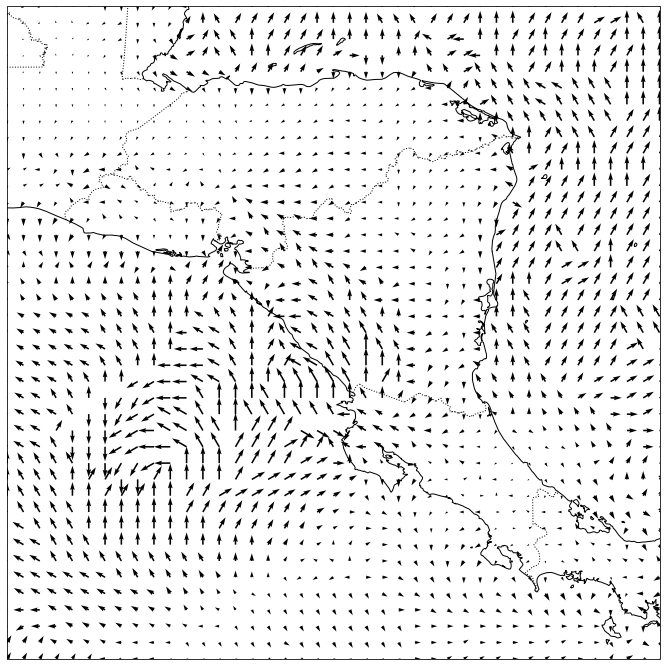

In [65]:
fig = plt.figure(figsize=[12, 12])
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())
ax.set_extent([-91, -81, 7, 17], crs=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.quiver(x = x, y = y, u = umax, v = vmax, transform = ccrs.PlateCarree())
plt.show()

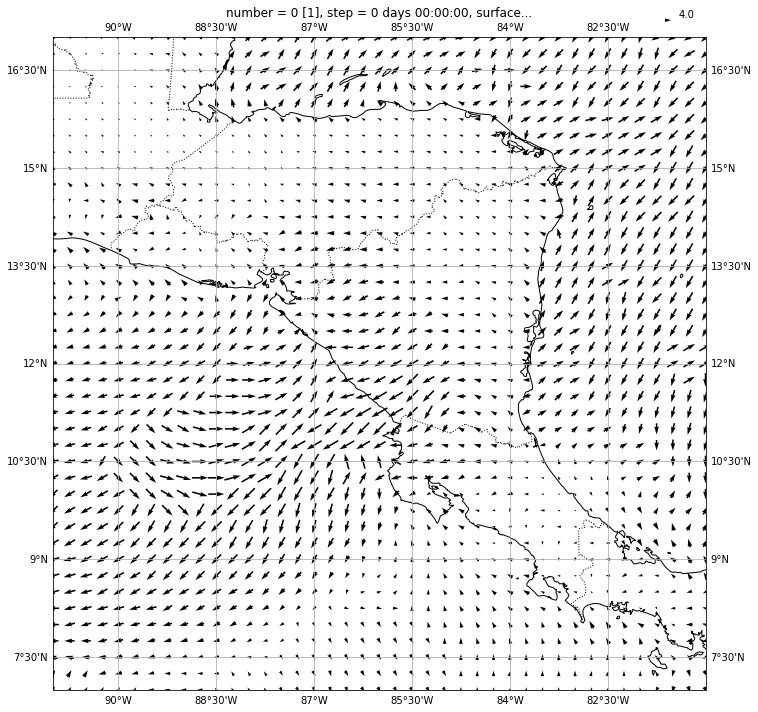

In [89]:
fig = plt.figure(figsize=[12, 12])
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())
ax.set_extent([-91, -81, 7, 17], crs=ccrs.PlateCarree())
wsmax_ds.isel(year = 0, month = 0).plot.quiver(ax = ax, x = "longitude", y = "latitude", u = "umax", v = "vmax")
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False)
plt.show()

In [81]:
ws_da_argmax.isel(year = 0, month = 0).sel(latitude = 16.5, longitude = -82.5).data.compute()

14

In [90]:
ws_da_argmax.isel(year = 0, month = 0).sel(latitude = 11.25, longitude = -88.5).data.compute()

6

In [91]:
client.close()

In [32]:
test2 = wsmax_ds.metpy.parse_cf()

In [33]:
test2

<xarray.Dataset>
Dimensions:    (latitude: 41, longitude: 41, year: 16, month: 12)
Coordinates:
    number     int64 0
    step       timedelta64[ns] 00:00:00
    surface    float64 0.0
  * latitude   (latitude) float64 17.0 16.75 16.5 16.25 ... 7.75 7.5 7.25 7.0
  * longitude  (longitude) float64 -91.0 -90.75 -90.5 ... -81.5 -81.25 -81.0
    metpy_crs  object Projection: latitude_longitude
Dimensions without coordinates: year, month
Data variables:
    umax       (year, month, latitude, longitude) float64 dask.array<chunksize=(16, 12, 41, 41), meta=np.ndarray>
    vmax       (year, month, latitude, longitude) float64 dask.array<chunksize=(16, 12, 41, 41), meta=np.ndarray>

In [ ]:
test2

In [34]:
test2.metpy.cartopy_crs

AttributeError: 'MetPyDatasetAccessor' object has no attribute 'cartopy_crs'

In [24]:
test = ws_ds.metpy.parse_cf("si10")

In [28]:
test.metpy.cartopy_crs

<Derived Projected CRS: +proj=eqc +ellps=WGS84 +a=6378137.0 +lon_0=0.0 +to ...>
Name: unknown
Axis Info [cartesian]:
- E[east]: Easting (unknown)
- N[north]: Northing (unknown)
- h[up]: Ellipsoidal height (metre)
Area of Use:
- undefined
Coordinate Operation:
- name: unknown
- method: Equidistant Cylindrical
Datum: unknown
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [29]:
test

<xarray.DataArray 'si10' (time: 4608, latitude: 41, longitude: 41)>
dask.array<open_dataset-a541cbfa23548abfed9726019b7b55d8si10, shape=(4608, 41, 41), dtype=float32, chunksize=(4608, 41, 41), chunktype=numpy.ndarray>
Coordinates:
    number      int64 ...
  * time        (time) datetime64[ns] 1990-01-01 ... 2005-12-01T23:00:00
    step        timedelta64[ns] ...
    surface     float64 ...
  * latitude    (latitude) float64 17.0 16.75 16.5 16.25 ... 7.75 7.5 7.25 7.0
  * longitude   (longitude) float64 -91.0 -90.75 -90.5 ... -81.5 -81.25 -81.0
    valid_time  (time) datetime64[ns] dask.array<chunksize=(4608,), meta=np.ndarray>
    metpy_crs   object Projection: latitude_longitude
Attributes:
    GRIB_paramId:                             207
    GRIB_dataType:                            an
    GRIB_numberOfPoints:                      1681
    GRIB_typeOfLevel:                         surface
    GRIB_stepUnits:                           1
    GRIB_stepType:                            avgua
    GRIB_gridType:                            regular_ll
    GRIB_NV:                                  0
    GRIB_Nx:                                  41
    GRIB_Ny:                                  41
    GRIB_cfName:                              unknown
    GRIB_cfVarName:                           si10
    GRIB_gridDefinitionDescription:           Latitude/Longitude Grid
    GRIB_iDirectionIncrementInDegrees:        0.25
    GRIB_iScansNegatively:                    0
    GRIB_jDirectionIncrementInDegrees:        0.25
    GRIB_jPointsAreConsecutive:               0
    GRIB_jScansPositively:                    0
    GRIB_latitudeOfFirstGridPointInDegrees:   17.0
    GRIB_latitudeOfLastGridPointInDegrees:    7.0
    GRIB_longitudeOfFirstGridPointInDegrees:  -91.0
    GRIB_longitudeOfLastGridPointInDegrees:   -81.0
    GRIB_missingValue:                        9999
    GRIB_name:                                10 metre wind speed
    GRIB_shortName:                           10si
    GRIB_totalNumber:                         0
    GRIB_units:                               m s**-1
    long_name:                                10 metre wind speed
    units:                                    m s**-1
    standard_name:                            unknown

In [31]:
ws_da.metpy.cartopy_crs

AttributeError: crs attribute is not available. You may need to use the `parse_cf` or `assign_crs` methods. Consult the "xarray with MetPy Tutorial" for more details.

In [30]:
ws_da

<xarray.DataArray 'si10' (time: 4608, latitude: 41, longitude: 41)>
dask.array<open_dataset-a541cbfa23548abfed9726019b7b55d8si10, shape=(4608, 41, 41), dtype=float32, chunksize=(4608, 41, 41), chunktype=numpy.ndarray>
Coordinates:
    number      int64 ...
  * time        (time) datetime64[ns] 1990-01-01 ... 2005-12-01T23:00:00
    step        timedelta64[ns] ...
    surface     float64 ...
  * latitude    (latitude) float64 17.0 16.75 16.5 16.25 ... 7.75 7.5 7.25 7.0
  * longitude   (longitude) float64 -91.0 -90.75 -90.5 ... -81.5 -81.25 -81.0
    valid_time  (time) datetime64[ns] dask.array<chunksize=(4608,), meta=np.ndarray>
Attributes:
    GRIB_paramId:                             207
    GRIB_dataType:                            an
    GRIB_numberOfPoints:                      1681
    GRIB_typeOfLevel:                         surface
    GRIB_stepUnits:                           1
    GRIB_stepType:                            avgua
    GRIB_gridType:                            regular_ll
    GRIB_NV:                                  0
    GRIB_Nx:                                  41
    GRIB_Ny:                                  41
    GRIB_cfName:                              unknown
    GRIB_cfVarName:                           si10
    GRIB_gridDefinitionDescription:           Latitude/Longitude Grid
    GRIB_iDirectionIncrementInDegrees:        0.25
    GRIB_iScansNegatively:                    0
    GRIB_jDirectionIncrementInDegrees:        0.25
    GRIB_jPointsAreConsecutive:               0
    GRIB_jScansPositively:                    0
    GRIB_latitudeOfFirstGridPointInDegrees:   17.0
    GRIB_latitudeOfLastGridPointInDegrees:    7.0
    GRIB_longitudeOfFirstGridPointInDegrees:  -91.0
    GRIB_longitudeOfLastGridPointInDegrees:   -81.0
    GRIB_missingValue:                        9999
    GRIB_name:                                10 metre wind speed
    GRIB_shortName:                           10si
    GRIB_totalNumber:                         0
    GRIB_units:                               m s**-1
    long_name:                                10 metre wind speed
    units:                                    m s**-1
    standard_name:                            unknown

In [1]:
# Import libraries

from datetime import datetime
import glob
import numpy as np
import matplotlib.pyplot as plt
import cmocean
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import xarray as xr
import xskillscore as xs
import hvplot.xarray
import metpy.calc as mpcalc
import metpy.plots as mpplots
from matplotlib.patheffects import withStroke
from metpy.io import parse_metar_file
from metpy.units import pandas_dataframe_to_unit_arrays
from siphon.catalog import TDSCatalog
import re
import dask
from dask.distributed import Client

In [16]:
ds_si10 = xr.open_dataset("../data_raw/era5slvmonthhour-costa/ws_10m",
                          chunks = {'time': '500MB'},
                          engine = "cfgrib")

ds_si10 = (ds_si10
           .assign_coords({"latitude": ds_si10.latitude - 0.125,   # shift lat and lon coordinates by half of grid cell size since ERA5 data uses coordinates to define top left of grid cell
                           "longitude": (ds_si10.longitude + 180 + 0.125) % 360 - 180})  # whereas xarray plotting assumes coordinates refer to middle of grid cell
           .sortby("longitude")
          )

In [17]:
ds_z = xr.open_dataset("../data_raw/era5slvmonthhour-costa/geop.grib",
                          chunks = {'time': '500MB'},
                          engine = "cfgrib")

ds_z = (ds_z
           .assign_coords({"latitude": ds_z.latitude - 0.125,   # shift lat and lon coordinates by half of grid cell size since ERA5 data uses coordinates to define top left of grid cell
                           "longitude": (ds_z.longitude + 180 + 0.125) % 360 - 180})  # whereas xarray plotting assumes coordinates refer to middle of grid cell
           .sortby("longitude")
          )

In [18]:
ds_lsm = xr.open_dataset("../data_raw/era5slvmonthhour-costa/lsm.grib",
                          chunks = {'time': '500MB'})#,
                          #engine = "cfgrib")

ds_lsm = (ds_lsm
           .assign_coords({"latitude": ds_lsm.latitude - 0.125,   # shift lat and lon coordinates by half of grid cell size since ERA5 data uses coordinates to define top left of grid cell
                           "longitude": (ds_lsm.longitude + 180 + 0.125) % 360 - 180})  # whereas xarray plotting assumes coordinates refer to middle of grid cell
           .sortby("longitude")
       )

In [19]:
ds_si10, ds_z, ds_lsm = xr.align(ds_si10, ds_z, ds_lsm, join = "inner") # perform inner join

In [9]:
da_si10 = (
    ds_si10["si10"]
    .coarsen(time=24)
    .construct(time=("yearmonth", "hour"))
    .coarsen(yearmonth=12)
    .construct(yearmonth = ("year", "month"))
)

da_si10_max = da_si10.max(dim = "hour")
da_si10_argmax = da_si10.argmax(dim = "hour")/24*2*np.pi
da_si10_argmax_u = np.sin(da_si10_argmax)
da_si10_argmax_v = np.cos(da_si10_argmax)

In [10]:
ds_si10_maxtime = xr.Dataset(
    data_vars = {"si10_max": da_si10_max,
                 "si10_argmax": da_si10_argmax,
                 "si10_argmax_u": da_si10_argmax_u,
                 "si10_argmax_v": da_si10_argmax_v}
)

In [11]:
da_alti = ds_z["z"].where(ds_lsm["lsm"] > 0.5) / 9.8

In [12]:
# Open dask client

client = Client()
client

2022-07-18 23:27:12,463 - distributed.diskutils - INFO - Found stale lock file and directory '/home/anthony/Drive/Thesis/sandbox/dask-worker-space/worker-vb6pm3di', purging
2022-07-18 23:27:12,463 - distributed.diskutils - INFO - Found stale lock file and directory '/home/anthony/Drive/Thesis/sandbox/dask-worker-space/worker-7pq_6w7p', purging
2022-07-18 23:27:12,464 - distributed.diskutils - INFO - Found stale lock file and directory '/home/anthony/Drive/Thesis/sandbox/dask-worker-space/worker-qxgxx4uf', purging
2022-07-18 23:27:12,464 - distributed.diskutils - INFO - Found stale lock file and directory '/home/anthony/Drive/Thesis/sandbox/dask-worker-space/worker-mc09iu6k', purging


Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:8787/status,
Dashboard: http://127.0.0.1:8787/status,Workers: 4
Total threads: 12,Total memory: 15.48 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:42371,Workers: 4
Dashboard: http://127.0.0.1:8787/status,Total threads: 12
Started: Just now,Total memory: 15.48 GiB
Comm: tcp://127.0.0.1:45099,Total threads: 3
Dashboard: http://127.0.0.1:45581/status,Memory: 3.87 GiB
Nanny: tcp://127.0.0.1:35851,


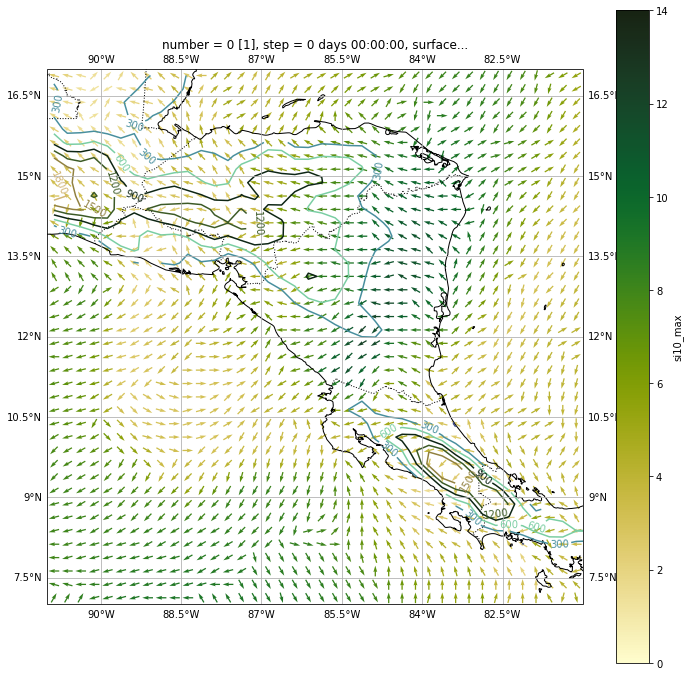

In [13]:
fig = plt.figure(figsize=[12, 12])
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())
ax.set_extent([-91, -81, 7, 17], crs=ccrs.PlateCarree())
cs = ax.contour(da_alti["longitude"], da_alti["latitude"], da_alti, 
                cmap = cmocean.cm.topo, transform=ccrs.PlateCarree())
ax.clabel(cs)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS, linestyle=':')
ds_si10_maxtime.isel(year = 0, month = 0).plot.quiver(
    ax = ax, x = "longitude", y = "latitude", u = "si10_argmax_u", v = "si10_argmax_v", 
    hue = "si10_max", cmap = cmocean.cm.speed, scale=50, vmin=0, vmax=14, transform=ccrs.PlateCarree())
ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
plt.show()

In [14]:
client.close()

In [2]:
cat_lai_year = TDSCatalog("https://www.ncei.noaa.gov/thredds/catalog/cdr/lai/catalog.xml")

In [3]:
cat_lai_year.catalog_refs

['1981', '1982', '1983', '1984', '1985', '1986', '1987', '1988', '1989', '1990', '1991', '1992', '1993', '1994', '1995', '1996', '1997', '1998', '1999', '2000', '2001', '2002', '2003', '2004', '2005', '2006', '2007', '2008', '2009', '2010', '2011', '2012', '2013', '2014', '2015', '2016', '2017', '2018', '2019', '2020', '2021', '2022']

In [4]:
cat_lai_1981 = TDSCatalog("https://www.ncei.noaa.gov/thredds/catalog/cdr/lai/1981/catalog.xml")

In [11]:
mylist = list(cat_lai_1981.datasets)
r = re.compile(".*15_c.*")
newlist = list(filter(r.match, mylist)) # Read Note
print(newlist)

['AVHRR-Land_v005_AVH15C1_NOAA-07_19810715_c20181025195309.nc', 'AVHRR-Land_v005_AVH15C1_NOAA-07_19810815_c20181025200934.nc', 'AVHRR-Land_v005_AVH15C1_NOAA-07_19810915_c20181025202559.nc', 'AVHRR-Land_v005_AVH15C1_NOAA-07_19811015_c20181025204207.nc', 'AVHRR-Land_v005_AVH15C1_NOAA-07_19811115_c20181025205857.nc', 'AVHRR-Land_v005_AVH15C1_NOAA-07_19811215_c20181025211455.nc']


In [48]:
cat_lai_1981.datasets[newlist[0]]

AVHRR-Land_v005_AVH15C1_NOAA-07_19810715_c20181025195309.nc

In [69]:
cat_lai_2005 = TDSCatalog("https://www.ncei.noaa.gov/thredds/catalog/cdr/lai/2005/catalog.xml")

In [70]:
test = cat_lai_2005.datasets['AVHRR-Land_v005_AVH15C1_NOAA-16_20050710_c20180830184813.nc'].remote_access(use_xarray=True).sel(latitude = slice(17, 7), longitude = slice(-91, -81))

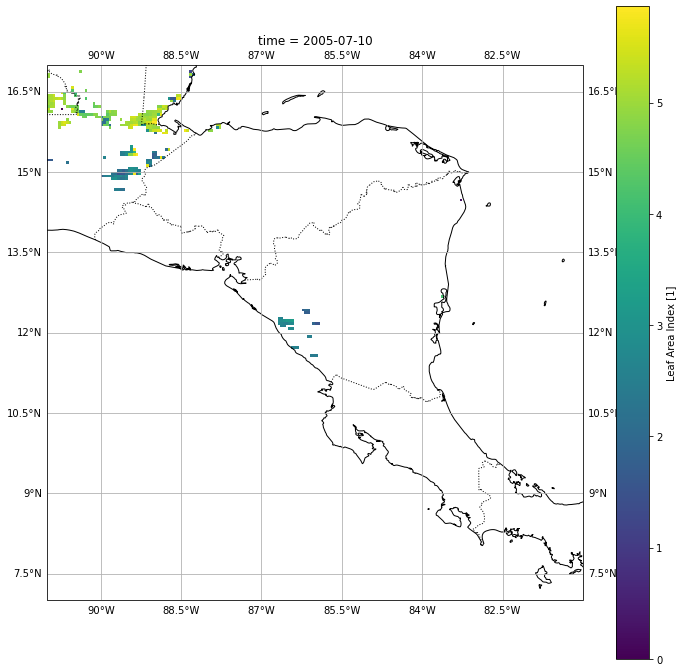

In [71]:
fig = plt.figure(figsize=[12, 12])
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())
ax.set_extent([-91, -81, 7, 17], crs=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
test["LAI"].plot()
plt.show()

In [134]:
lai_files = glob.glob("../data_raw/c3slaiv3-global/*.nc")
lai_files.sort()
lai_ds = xr.open_mfdataset(lai_files, 
                           chunks = {'time': '500MB'},
                           engine = "netcdf4")

In [135]:
lai_da = lai_ds["LAI"]
lai_da = (lai_da
          .assign_coords({"lat": lai_da.lat - 1/60, # shift lat and lon coordinates by half of grid cell size since ERA5 data uses coordinates to define top left of grid cell
                          "lon": lai_da.lon + 1/60, # whereas xarray plotting assumes coordinates refer to middle of grid cell
                         })
         .sel(lat = slice(17, 7), lon = slice(-91, -81))
         .isel(time = 102))

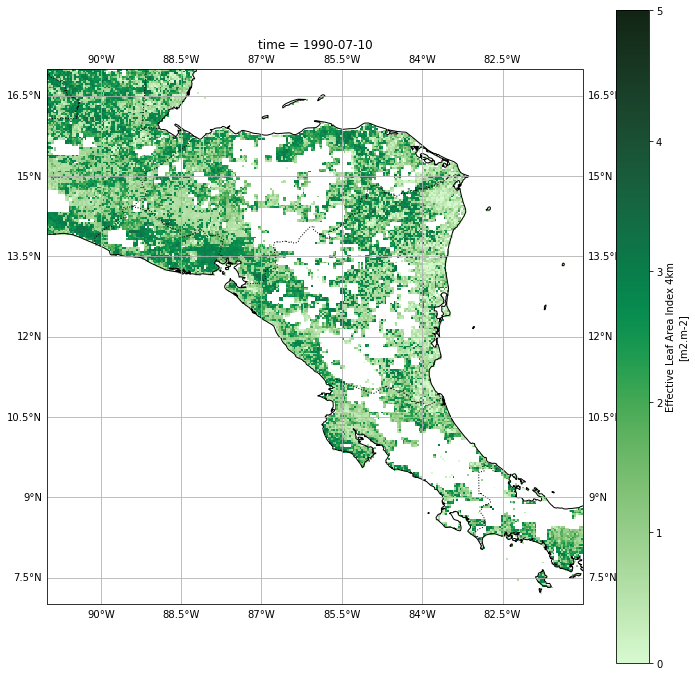

In [136]:
fig = plt.figure(figsize=[12, 12])
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())
ax.set_extent([-91, -81, 7, 17], crs=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
lai_da.plot(cmap = cmocean.cm.algae, vmin = 0, vmax = 5)
plt.show()

In [137]:
lai_da = lai_ds["LAI"]
lai_da = (lai_da
          .assign_coords({"lat": lai_da.lat - 1/60, # shift lat and lon coordinates by half of grid cell size since ERA5 data uses coordinates to define top left of grid cell
                          "lon": lai_da.lon + 1/60, # whereas xarray plotting assumes coordinates refer to middle of grid cell
                         })
         .sel(lat = slice(17, 7), lon = slice(-91, -81))
         .isel(time = -6))

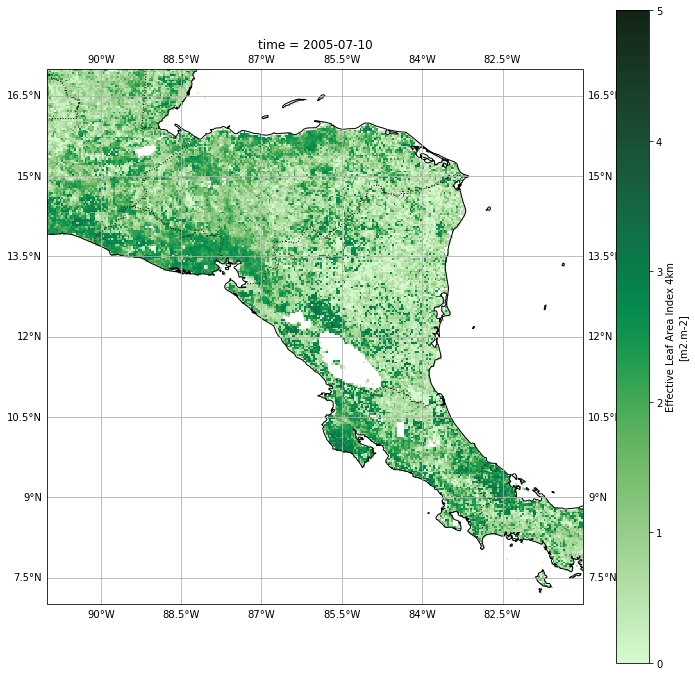

In [138]:
fig = plt.figure(figsize=[12, 12])
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())
ax.set_extent([-91, -81, 7, 17], crs=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
lai_da.plot(cmap = cmocean.cm.algae, vmin = 0, vmax = 5)
plt.show()

In [139]:
lai_files = glob.glob("../data_raw/c3slaiv3-global/*.nc")
lai_files.sort()
lai_ds = xr.open_mfdataset(lai_files, 
                           chunks = {'time': '500MB'},
                           engine = "netcdf4")

In [140]:
lai_da = lai_ds["LAI"]
lai_da = (lai_da
          .assign_coords({"lat": lai_da.lat - 1/60, # shift lat and lon coordinates by half of grid cell size since ERA5 data uses coordinates to define top left of grid cell
                          "lon": lai_da.lon + 1/60, # whereas xarray plotting assumes coordinates refer to middle of grid cell
                         })
         .sel(lat = slice(-17, -32), lon = slice(-71, -39))
         .isel(time = 102))

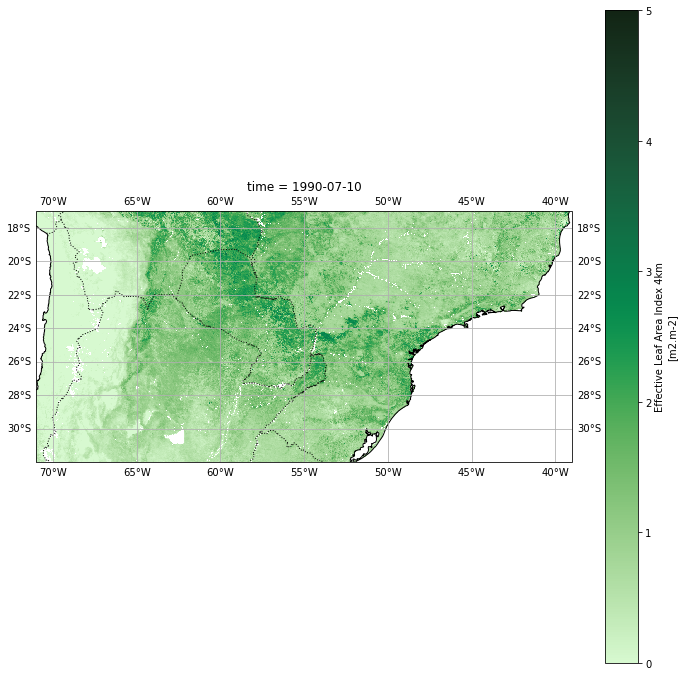

In [141]:
fig = plt.figure(figsize=[12, 12])
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())
ax.set_extent([-71, -39, -32, -17], crs=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
lai_da.plot(cmap = cmocean.cm.algae, vmin = 0, vmax = 5)
plt.show()

In [142]:
lai_da = lai_ds["LAI"]
lai_da = (lai_da
          .assign_coords({"lat": lai_da.lat - 1/60, # shift lat and lon coordinates by half of grid cell size since ERA5 data uses coordinates to define top left of grid cell
                          "lon": lai_da.lon + 1/60, # whereas xarray plotting assumes coordinates refer to middle of grid cell
                         })
         .sel(lat = slice(-17, -32), lon = slice(-71, -39))
         .isel(time = -6))

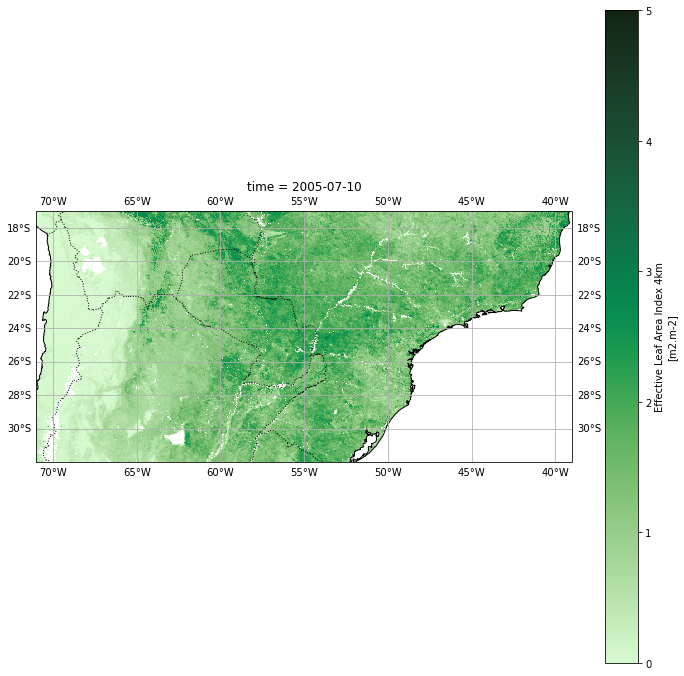

In [143]:
fig = plt.figure(figsize=[12, 12])
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())
ax.set_extent([-71, -39, -32, -17], crs=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
lai_da.plot(cmap = cmocean.cm.algae, vmin = 0, vmax = 5)
plt.show()

In [144]:
lai_ds = xr.open_dataset("../data_raw/GLASS01B02.V40.A1990193.2019353.hdf", 
                           chunks = {'time': '500MB'},
                           engine = "rasterio")

In [145]:
lai_da = lai_ds["band_data"]
lai_da = (lai_da
         .sel(y = slice(17, 7), x = slice(-91, -81)))

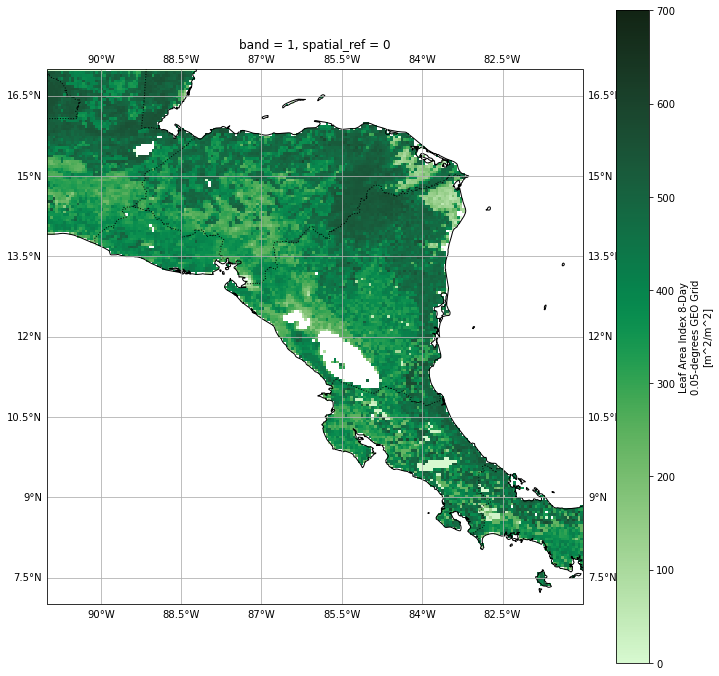

In [146]:
fig = plt.figure(figsize=[12, 12])
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())
ax.set_extent([-91, -81, 7, 17], crs=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
lai_da.plot(cmap = cmocean.cm.algae, vmin = 0, vmax = 700)
plt.show()

In [147]:
lai_ds = xr.open_dataset("../data_raw/GLASS01B02.V40.A2005193.2019353.hdf", 
                           chunks = {'time': '500MB'},
                           engine = "rasterio")

In [148]:
lai_da = lai_ds["band_data"]
lai_da = (lai_da
         .sel(y = slice(17, 7), x = slice(-91, -81)))

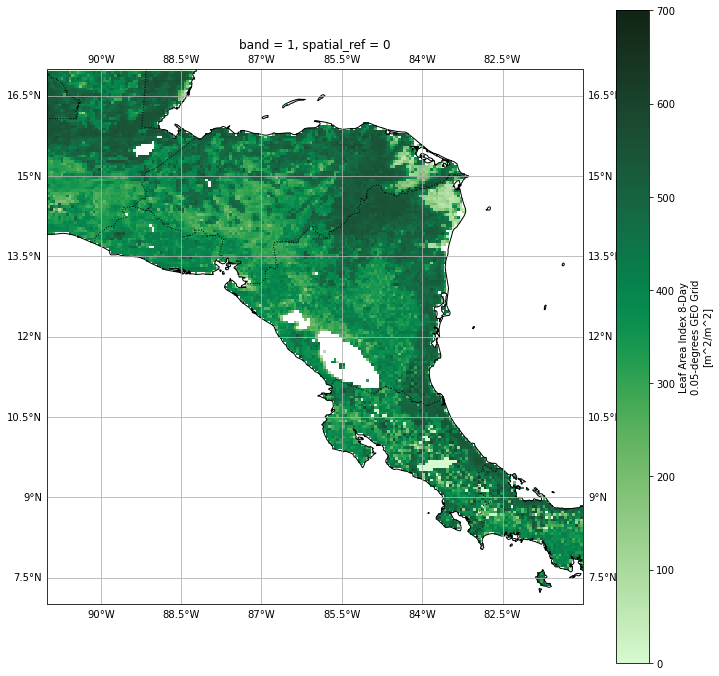

In [149]:
fig = plt.figure(figsize=[12, 12])
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())
ax.set_extent([-91, -81, 7, 17], crs=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
lai_da.plot(cmap = cmocean.cm.algae, vmin = 0, vmax = 700)
plt.show()

In [150]:
lai_ds = xr.open_dataset("../data_raw/GLASS01B02.V40.A1990193.2019353.hdf", 
                           chunks = {'time': '500MB'},
                           engine = "rasterio")

In [151]:
lai_da = lai_ds["band_data"]
lai_da = (lai_da
         .sel(y = slice(-17, -32), x = slice(-71, -39)))

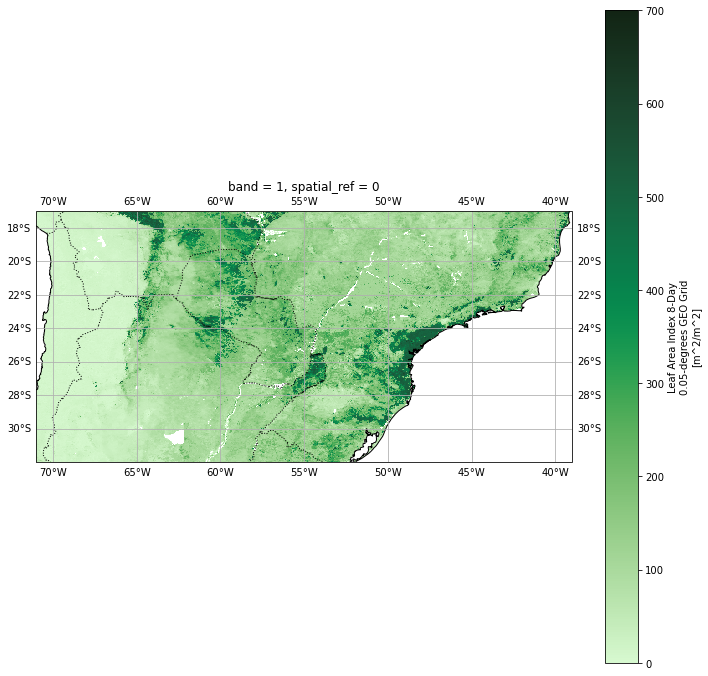

In [152]:
fig = plt.figure(figsize=[12, 12])
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())
ax.set_extent([-71, -39, -32, -17], crs=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
lai_da.plot(cmap = cmocean.cm.algae, vmin = 0, vmax = 700)
plt.show()

In [158]:
lai_ds = xr.open_dataset("../data_raw/GLASS01B02.V40.A2005193.2019353.hdf", 
                           chunks = {'time': '500MB'},
                           engine = "rasterio")

In [159]:
lai_da = lai_ds["band_data"]
lai_da = (lai_da
         .sel(y = slice(-17, -32), x = slice(-71, -39)))

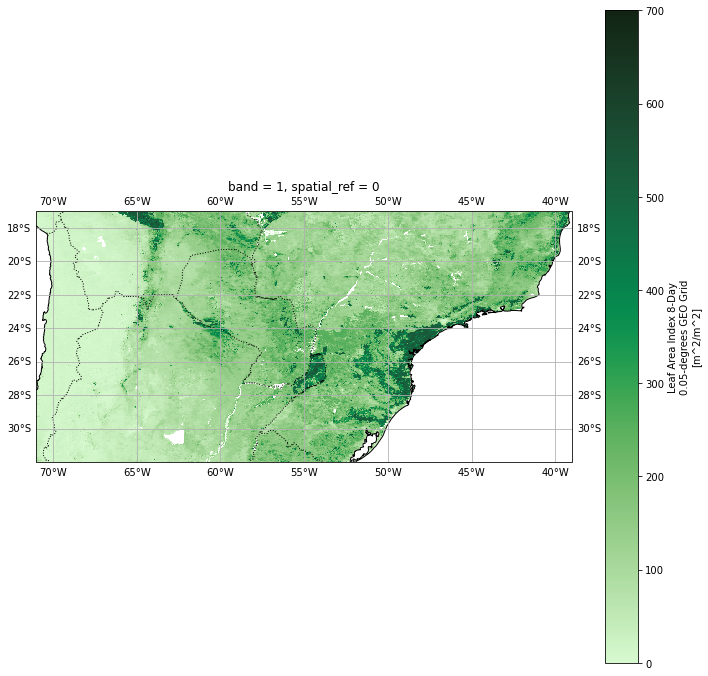

In [167]:
fig = plt.figure(figsize=[12, 12])
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())
ax.set_extent([-71, -39, -32, -17], crs=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
lai_da.plot(cmap = cmocean.cm.algae, vmin = 0, vmax = 700)
plt.show()

In [41]:
lai_ds = xr.open_dataset("../data_raw/GLASS01B02.V40.A1981193.2019353.hdf", 
                           chunks = {'time': '500MB'},
                           engine = "rasterio")

In [42]:
lai_da = lai_ds["band_data"]
lai_da = (lai_da
         .sel(y = slice(2, -38), x = slice(-70, -30)))

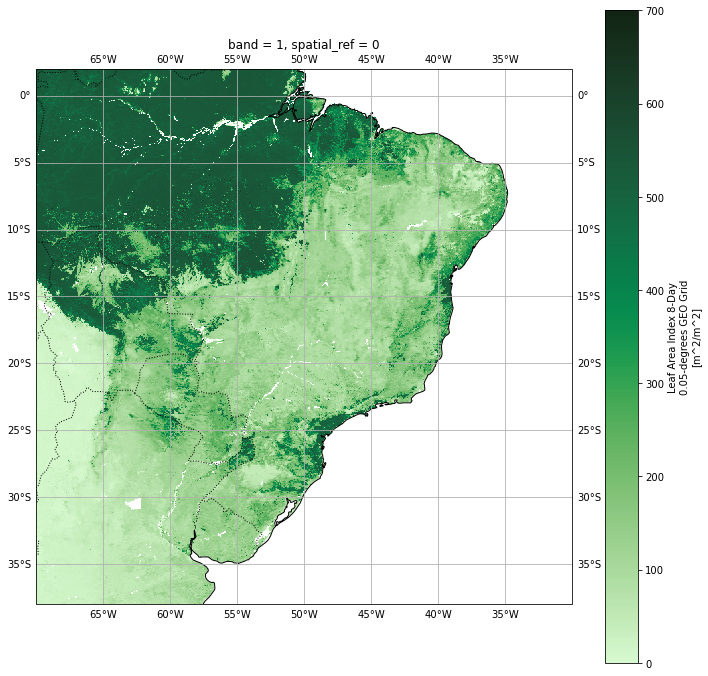

In [43]:
fig = plt.figure(figsize=[12, 12])
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())
ax.set_extent([-70, -30, -38, 2], crs=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
lai_da.plot(cmap = cmocean.cm.algae, vmin = 0, vmax = 700)
plt.show()

In [31]:
lai_ds = xr.open_dataset("../data_raw/GLASS01B02.V40.A1990193.2019353.hdf", 
                           chunks = {'time': '500MB'},
                           engine = "rasterio")

In [32]:
lai_da = lai_ds["band_data"]
lai_da = (lai_da
         .sel(y = slice(2, -38), x = slice(-70, -30)))

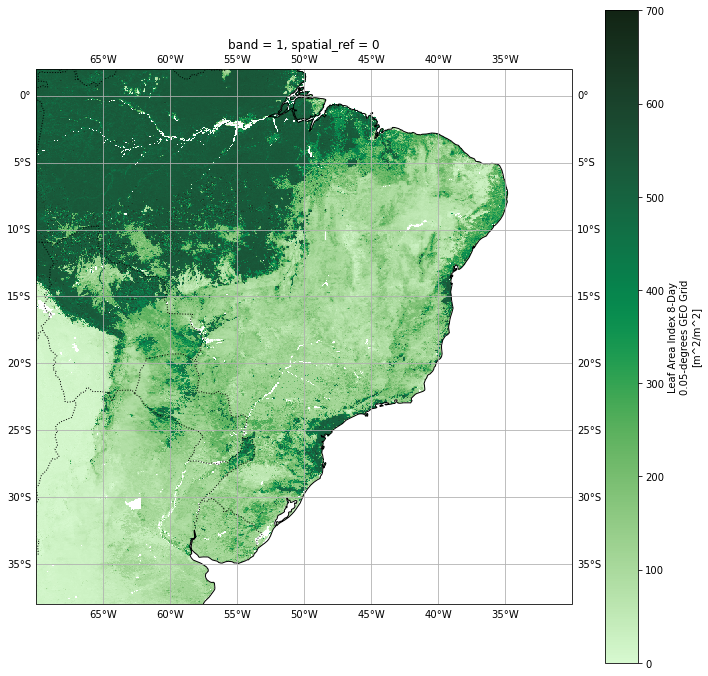

In [33]:
fig = plt.figure(figsize=[12, 12])
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())
ax.set_extent([-70, -30, -38, 2], crs=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
lai_da.plot(cmap = cmocean.cm.algae, vmin = 0, vmax = 700)
plt.show()

In [34]:
lai_ds = xr.open_dataset("../data_raw/GLASS01B02.V40.A2005193.2019353.hdf", 
                           chunks = {'time': '500MB'},
                           engine = "rasterio")

In [35]:
lai_da = lai_ds["band_data"]
lai_da = (lai_da
         .sel(y = slice(2, -38), x = slice(-70, -30)))

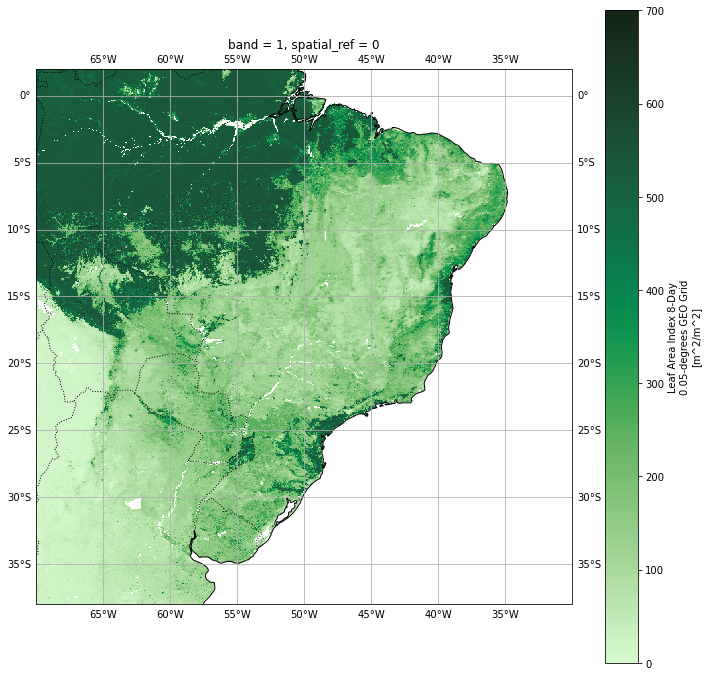

In [36]:
fig = plt.figure(figsize=[12, 12])
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())
ax.set_extent([-70, -30, -38, 2], crs=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
lai_da.plot(cmap = cmocean.cm.algae, vmin = 0, vmax = 700)
plt.show()

In [38]:
lai_ds = xr.open_dataset("../data_raw/GLASS01B02.V40.A2018193.2019358.hdf", 
                           chunks = {'time': '500MB'},
                           engine = "rasterio")

In [39]:
lai_da = lai_ds["band_data"]
lai_da = (lai_da
         .sel(y = slice(2, -38), x = slice(-70, -30)))

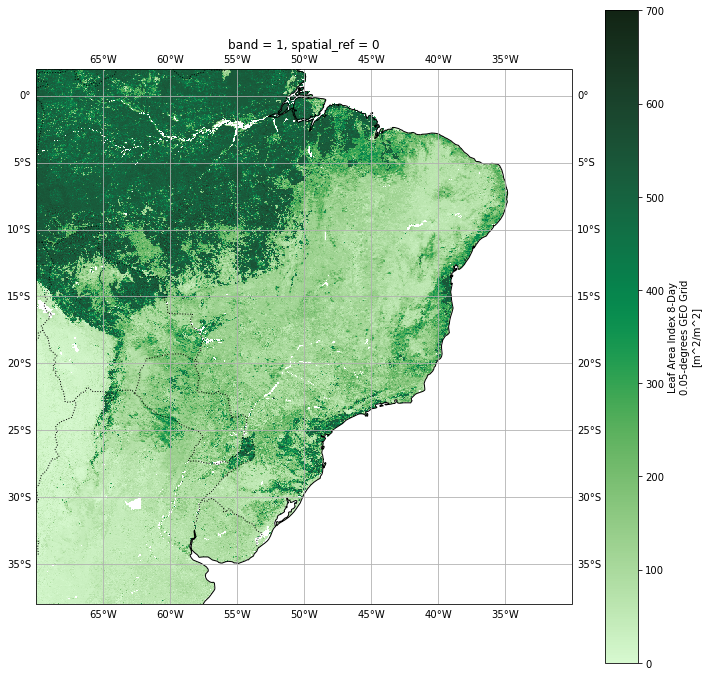

In [40]:
fig = plt.figure(figsize=[12, 12])
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())
ax.set_extent([-70, -30, -38, 2], crs=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
lai_da.plot(cmap = cmocean.cm.algae, vmin = 0, vmax = 700)
plt.show()

In [34]:
lai_ds = xr.open_dataset("../data_raw/GLASS01B02.V40.A1990193.2019353.hdf", 
                           chunks = {'time': '500MB'},
                           engine = "rasterio")

In [51]:
lai_da = lai_ds["band_data"] * 1
lai_da = (lai_da
         .sel(y = slice(-17, -32), x = slice(-71, -39)))

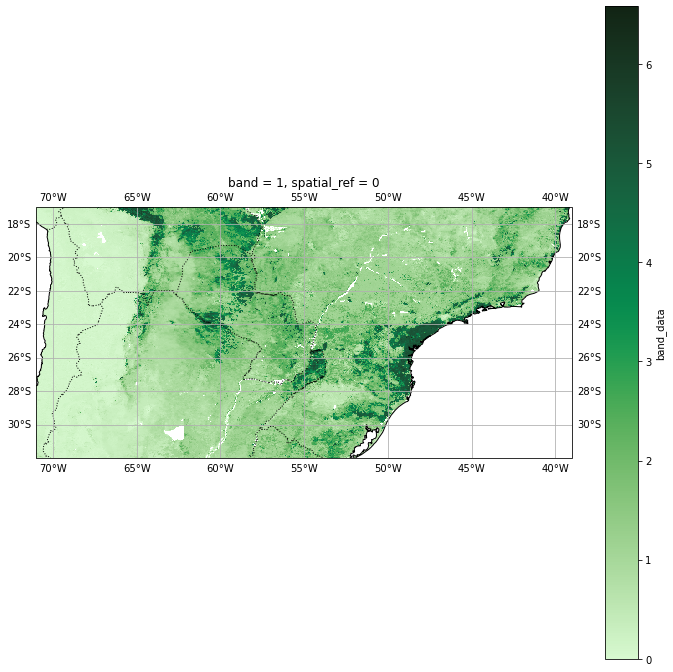

In [52]:
fig = plt.figure(figsize=[12, 12])
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())
ax.set_extent([-71, -39, -32, -17], crs=ccrs.PlateCarree())
lai_da.plot(ax = ax, cmap = cmocean.cm.algae, transform=ccrs.PlateCarree())
ax.plot
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
plt.show()

In [56]:
# fig = plt.figure(figsize=[12, 12])
# ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())
# ax.set_extent([-91, -81, 7, 17], crs=ccrs.PlateCarree())
ws_ds_maxtime.isel(year = 0, month = 0).hvplot.vectorfield(x = "longitude", y = "latitude", angle = "ws_da_argmax", mag = "ws")
# ax.add_feature(cfeature.COASTLINE)
# ax.add_feature(cfeature.BORDERS, linestyle=':')
# ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
# plt.show()

DataError: Supplied data does not contain specified dimensions, the following dimensions were not found: ['ws_da_argmax']

PandasInterface expects tabular data, for more information on supported datatypes see http://holoviews.org/user_guide/Tabular_Datasets.html

In [7]:
ds_si10

<xarray.Dataset>
Dimensions:     (latitude: 41, longitude: 41, time: 4608)
Coordinates:
  * latitude    (latitude) float64 16.88 16.62 16.38 16.12 ... 7.375 7.125 6.875
  * longitude   (longitude) float64 -90.88 -90.62 -90.38 ... -81.12 -80.88
    number      int64 0
  * time        (time) datetime64[ns] 1990-01-01 ... 2005-12-01T23:00:00
    step        timedelta64[ns] 00:00:00
    surface     float64 0.0
    valid_time  (time) datetime64[ns] dask.array<chunksize=(4608,), meta=np.ndarray>
Data variables:
    si10        (time, latitude, longitude) float32 dask.array<chunksize=(4608, 41, 41), meta=np.ndarray>
Attributes:
    GRIB_edition:            1
    GRIB_centre:             ecmf
    GRIB_centreDescription:  European Centre for Medium-Range Weather Forecasts
    GRIB_subCentre:          0
    Conventions:             CF-1.7
    institution:             European Centre for Medium-Range Weather Forecasts
    history:                 2022-07-23T23:14 GRIB to CDM+CF via cfgrib-0.9.1...

In [8]:
ds_lai

<xarray.Dataset>
Dimensions:      (band: 1, longitude: 7200, latitude: 3600)
Coordinates:
  * band         (band) int64 1
  * longitude    (longitude) float64 -180.0 -179.9 -179.9 ... 179.9 179.9 180.0
  * latitude     (latitude) float64 89.97 89.92 89.88 ... -89.88 -89.93 -89.98
    spatial_ref  int64 ...
Data variables:
    band_data    (band, latitude, longitude) float32 dask.array<chunksize=(1, 3600, 7200), meta=np.ndarray>

In [3]:
# Import libraries

from datetime import datetime
import glob
import numpy as np
import matplotlib.pyplot as plt
import cmocean
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import xarray as xr
import xskillscore as xs
import hvplot.xarray
import metpy.calc as mpcalc
import metpy.plots as mpplots
from matplotlib.patheffects import withStroke
from metpy.io import parse_metar_file
from metpy.units import pandas_dataframe_to_unit_arrays
from siphon.catalog import TDSCatalog
import re
import dask
import gc
from dask.distributed import Client

In [44]:
extent = {"ca": [-91, -81, 7, 17],
          "sa": [-65, -30, -15, 0],
          "wa": [113, 123, -35, -30]}

In [ ]:
tz = {"ca": -6, # +- 0
      "sa": -3, # +- 1.5
      "wa": +8} # +- 0

In [22]:
extent = [-91, -81, 7, 17]
var_dict1 = {"file": "si10"}
var_dict2 = {"file": "Maximum wind speed"}
var = var_dict1["file"]
param = "max"
a = var + "_" + param
b = var + "_" + "arg" + param
c = var + "_" + "arg" + param + "_u"
d = var + "_" + "arg" + param + "_v"
x = ds_si10[var]
y = x.attrs["long_name"] + " (" + x.attrs["units"] + ")"
y = var_dict2

In [4]:
ds_si10 = xr.open_dataset("../data_archived/era5slvmonthhour-costa/ws_10m",
                          chunks = {'time': '500MB'},
                          engine = "cfgrib")

ds_si10 = (ds_si10
           .assign_coords({"latitude": ds_si10.latitude - 0.125,   # shift lat and lon coordinates by half of grid cell size since ERA5 data uses coordinates to define top left of grid cell
                           "longitude": (ds_si10.longitude + 180 + 0.125) % 360 - 180})  # whereas xarray plotting assumes coordinates refer to middle of grid cell
           .sortby("longitude")
          )

ds_z = xr.open_dataset("../data_archived/era5slvmonthhour-costa/geop.grib",
                          chunks = {'time': '500MB'},
                          engine = "cfgrib")

ds_z = (ds_z
        .assign_coords({"latitude": ds_z.latitude - 0.125,   # shift lat and lon coordinates by half of grid cell size since ERA5 data uses coordinates to define top left of grid cell
                           "longitude": (ds_z.longitude + 180 + 0.125) % 360 - 180})  # whereas xarray plotting assumes coordinates refer to middle of grid cell
        .sortby("longitude")
       )

ds_lsm = xr.open_dataset("../data_archived/era5slvmonthhour-costa/lsm.grib",
                          chunks = {'time': '500MB'},
                          engine = "cfgrib")

ds_lsm = (ds_lsm
          .assign_coords({"latitude": ds_lsm.latitude - 0.125,   # shift lat and lon coordinates by half of grid cell size since ERA5 data uses coordinates to define top left of grid cell
                          "longitude": (ds_lsm.longitude + 180 + 0.125) % 360 - 180})  # whereas xarray plotting assumes coordinates refer to middle of grid cell
          .sortby("longitude")
         )

ds_lai = xr.open_dataset("../data_archived/GLASS01B02.V40.A1990193.2019353.hdf", 
                           chunks = {'time': '500MB'},
                           engine = "rasterio")

ds_lai = (ds_lai
          .assign_coords({"x": (ds_lai.x + 180) % 360 - 180})
          .sortby("x")
          .rename({"x": "longitude", "y": "latitude"})
         )

ds_si10, ds_z, ds_lsm = xr.align(ds_si10, ds_z, ds_lsm, join = "inner") # perform inner join

In [3]:
da_si10 = (
    ds_si10["si10"]
    .coarsen(time=24)
    .construct(time=("yearmonth", "hour"))
    .coarsen(yearmonth=12)
    .construct(yearmonth = ("year", "month"))
)

da_si10_max = da_si10.max(dim = "hour")
da_si10_argmax = da_si10.argmax(dim = "hour")/24*2*np.pi
da_si10_argmax_u = np.sin(da_si10_argmax)
da_si10_argmax_v = np.cos(da_si10_argmax)

ds_si10_maxtime = xr.Dataset(
    data_vars = {"si10_max": da_si10_max,
                 "si10_argmax": da_si10_argmax,
                 "si10_argmax_u": da_si10_argmax_u,
                 "si10_argmax_v": da_si10_argmax_v}
).rename({"si10_max": "Wind speed"})

da_alti = ds_z["z"].where(ds_lsm["lsm"] > 0.5) / 9.80665
da_lai = ds_lai["band_data"].sel(latitude = slice(17, 7), longitude = slice(-91, -81)).rename("Leaf Area Index")*1

In [4]:
# Open dask client

client = Client()
client

2022-07-22 22:19:23,605 - distributed.diskutils - INFO - Found stale lock file and directory '/home/anthony/Drive/Thesis/sandbox/dask-worker-space/worker-isgg_qp0', purging
2022-07-22 22:19:23,606 - distributed.diskutils - INFO - Found stale lock file and directory '/home/anthony/Drive/Thesis/sandbox/dask-worker-space/worker-ffgryii4', purging
2022-07-22 22:19:23,606 - distributed.diskutils - INFO - Found stale lock file and directory '/home/anthony/Drive/Thesis/sandbox/dask-worker-space/worker-6sm1y4x1', purging
2022-07-22 22:19:23,606 - distributed.diskutils - INFO - Found stale lock file and directory '/home/anthony/Drive/Thesis/sandbox/dask-worker-space/worker-5_oy1d73', purging


Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:8787/status,
Dashboard: http://127.0.0.1:8787/status,Workers: 4
Total threads: 12,Total memory: 15.48 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:41641,Workers: 4
Dashboard: http://127.0.0.1:8787/status,Total threads: 12
Started: Just now,Total memory: 15.48 GiB
Comm: tcp://127.0.0.1:41261,Total threads: 3
Dashboard: http://127.0.0.1:39593/status,Memory: 3.87 GiB
Nanny: tcp://127.0.0.1:40271,


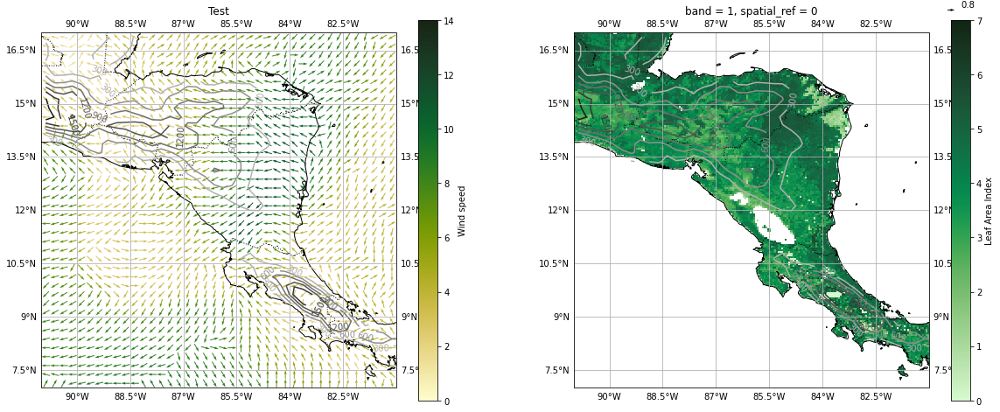

In [13]:
fig = plt.figure(figsize=[20, 8])

ax1 = fig.add_subplot(1, 2, 1, projection=ccrs.PlateCarree())
ax1.set_extent([-91, -81, 7, 17], crs=ccrs.PlateCarree())
ax1.add_feature(cfeature.COASTLINE)
ax1.add_feature(cfeature.BORDERS, linestyle=':')
ds_si10_maxtime.isel(year = 0, month = 0).plot.quiver(
    ax = ax1, x = "longitude", y = "latitude", u = "si10_argmax_u", v = "si10_argmax_v", 
    hue = "Wind speed", cmap = cmocean.cm.speed, scale=40, vmin=0, vmax=14, transform=ccrs.PlateCarree())
cs_alti1 = ax1.contour(da_alti["longitude"], da_alti["latitude"], da_alti, 
                cmap=cmocean.cm.gray_r, transform=ccrs.PlateCarree())
ax1.clabel(cs_alti1)
ax1.gridlines(draw_labels=True, x_inline=False, y_inline=False)
ax1.set_title("Test")

ax2 = fig.add_subplot(1, 2, 2, projection=ccrs.PlateCarree())
ax2.set_extent([-91, -81, 7, 17], crs=ccrs.PlateCarree())
da_lai.plot(ax = ax2, cmap = cmocean.cm.algae, vmin=0, vmax=7, transform=ccrs.PlateCarree())
ax2.add_feature(cfeature.COASTLINE)
ax2.add_feature(cfeature.BORDERS, linestyle=':')
cs_alti2 = ax2.contour(da_alti["longitude"], da_alti["latitude"], da_alti, 
                cmap=cmocean.cm.gray_r, transform=ccrs.PlateCarree())
ax1.clabel(cs_alti2)
ax2.gridlines(draw_labels=True, x_inline=False, y_inline=False)

plt.show()

In [33]:
client.close()

In [4]:
ds_era5 = xr.open_dataset("../data_archived/sa_era5-slv_month-hour_1980-2021_LARGE.nc",
                          chunks = {'time': '500MB'},
                          engine = "netcdf4")

In [5]:
ds_era5

<xarray.Dataset>
Dimensions:    (longitude: 161, latitude: 161, time: 15624)
Coordinates:
  * longitude  (longitude) float32 -70.0 -69.75 -69.5 ... -30.5 -30.25 -30.0
  * latitude   (latitude) float32 2.0 1.75 1.5 1.25 ... -37.5 -37.75 -38.0
  * time       (time) datetime64[ns] 1980-01-01 ... 2021-12-01T23:00:00
Data variables:
    u100       (time, latitude, longitude) float32 dask.array<chunksize=(3906, 161, 161), meta=np.ndarray>
    v100       (time, latitude, longitude) float32 dask.array<chunksize=(3906, 161, 161), meta=np.ndarray>
    u10        (time, latitude, longitude) float32 dask.array<chunksize=(3906, 161, 161), meta=np.ndarray>
    v10        (time, latitude, longitude) float32 dask.array<chunksize=(3906, 161, 161), meta=np.ndarray>
    t2m        (time, latitude, longitude) float32 dask.array<chunksize=(3906, 161, 161), meta=np.ndarray>
    msl        (time, latitude, longitude) float32 dask.array<chunksize=(3906, 161, 161), meta=np.ndarray>
    slhf       (time, latitude, longitude) float32 dask.array<chunksize=(3906, 161, 161), meta=np.ndarray>
    sshf       (time, latitude, longitude) float32 dask.array<chunksize=(3906, 161, 161), meta=np.ndarray>
Attributes:
    Conventions:  CF-1.6
    history:      2022-07-24 10:18:37 GMT by grib_to_netcdf-2.25.1: /opt/ecmw...

In [6]:
%%time
ds_era5["msl"].isel(longitude = slice(0, 5), latitude = slice(0, 5)).groupby("time").mean().compute()

CPU times: user 21.6 s, sys: 373 ms, total: 22 s
Wall time: 21.7 s


<xarray.DataArray 'msl' (time: 15624, latitude: 5, longitude: 5)>
array([[[100895.31 , 100897.17 , 100898.82 , 100895.57 , 100896.19 ],
        [100897.84 , 100900.32 , 100896.086, 100891.336, 100887.31 ],
        [100898.82 , 100901.555, 100892.94 , 100888.29 , 100881.945],
        [100897.17 , 100894.17 , 100889.06 , 100885.45 , 100877.71 ],
        [100891.18 , 100891.95 , 100883.18 , 100879.93 , 100878.43 ]],

       [[101010.99 , 101010.625, 101010.52 , 101005.77 , 101005.77 ],
        [101014.6  , 101014.86 , 101009.39 , 101003.61 , 100999.63 ],
        [101016.26 , 101016.516, 101007.12 , 101002.88 , 100996.74 ],
        [101013.984, 101009.49 , 101004.23 , 101001.75 , 100994.37 ],
        [101008.51 , 101009.03 , 101000.875, 100998.24 , 100996.28 ]],

       [[101078.45 , 101077.42 , 101076.55 , 101071.33 , 101070.71 ],
        [101082.33 , 101081.97 , 101075.82 , 101069.68 , 101065.7  ],
        [101084.7  , 101084.445, 101074.33 , 101069.68 , 101063.44 ],
        [101083.2  , 101078.3  , 101072.21 , 101068.96 , 101061.836],
        [101078.04 , 101078.3  , 101069.836, 101067.2  , 101065.19 ]],

       ...,

       [[       nan,        nan,        nan,        nan,        nan],
        [       nan,        nan,        nan,        nan,        nan],
        [       nan,        nan,        nan,        nan,        nan],
        [       nan,        nan,        nan,        nan,        nan],
        [       nan,        nan,        nan,        nan,        nan]],

       [[       nan,        nan,        nan,        nan,        nan],
        [       nan,        nan,        nan,        nan,        nan],
        [       nan,        nan,        nan,        nan,        nan],
        [       nan,        nan,        nan,        nan,        nan],
        [       nan,        nan,        nan,        nan,        nan]],

       [[       nan,        nan,        nan,        nan,        nan],
        [       nan,        nan,        nan,        nan,        nan],
        [       nan,        nan,        nan,        nan,        nan],
        [       nan,        nan,        nan,        nan,        nan],
        [       nan,        nan,        nan,        nan,        nan]]],
      dtype=float32)
Coordinates:
  * longitude  (longitude) float32 -70.0 -69.75 -69.5 -69.25 -69.0
  * latitude   (latitude) float32 2.0 1.75 1.5 1.25 1.0
  * time       (time) datetime64[ns] 1980-01-01 ... 2021-12-02T06:00:00

In [9]:
Out[6].nbytes

1562400

In [10]:
del Out[6]

In [11]:
gc.collect()

3229

In [9]:
%%time
ds_era5["msl"].isel(longitude = slice(0, 20), latitude = slice(0, 20)).groupby("time").mean().compute()

CPU times: user 22 s, sys: 346 ms, total: 22.3 s
Wall time: 22 s


<xarray.DataArray 'msl' (time: 15624, latitude: 20, longitude: 20)>
array([[[100895.31 , 100897.17 , 100898.82 , ..., 100891.336,
         100937.69 , 100910.336],
        [100897.84 , 100900.32 , 100896.086, ..., 100933.46 ,
         100988.43 , 100949.664],
        [100898.82 , 100901.555, 100892.94 , ..., 101000.305,
         101029.31 , 100990.96 ],
        ...,
        [100898.92 , 100897.586, 100902.44 , ..., 100890.2  ,
         100889.58 , 100889.836],
        [100895.83 , 100898.2  , 100902.695, ..., 100894.07 ,
         100895.055, 100892.836],
        [100887.67 , 100891.54 , 100892.94 , ..., 100898.82 ,
         100903.83 , 100901.71 ]],

       [[101010.99 , 101010.625, 101010.52 , ..., 100998.39 ,
         101047.28 , 101023.89 ],
        [101014.6  , 101014.86 , 101009.39 , ..., 101040.516,
         101098.27 , 101064.26 ],
        [101016.26 , 101016.516, 101007.12 , ..., 101107.1  ,
         101139.984, 101105.4  ],
...
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan]],

       [[       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        ...,
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan]]], dtype=float32)
Coordinates:
  * longitude  (longitude) float32 -70.0 -69.75 -69.5 ... -65.75 -65.5 -65.25
  * latitude   (latitude) float32 2.0 1.75 1.5 1.25 ... -2.0 -2.25 -2.5 -2.75
  * time       (time) datetime64[ns] 1980-01-01 ... 2021-12-02T06:00:00

In [15]:
%%time
ds_era5["msl"].groupby("time").mean().compute()

CPU times: user 27.4 s, sys: 2.62 s, total: 30 s
Wall time: 25.1 s


<xarray.DataArray 'msl' (time: 15624, latitude: 161, longitude: 161)>
array([[[100895.31 , 100897.17 , 100898.82 , ..., 101288.7  ,
         101289.06 , 101289.836],
        [100897.84 , 100900.32 , 100896.086, ..., 101286.586,
         101287.56 , 101288.336],
        [100898.82 , 100901.555, 100892.94 , ..., 101283.586,
         101284.83 , 101286.07 ],
        ...,
        [100967.58 , 100869.3  , 100794.55 , ..., 101525.68 ,
         101533.836, 101542.92 ],
        [100913.17 , 100863.46 , 100807.92 , ..., 101503.695,
         101511.336, 101520.93 ],
        [100915.19 , 100862.79 , 100787.84 , ..., 101485.836,
         101491.05 , 101499.56 ]],

       [[101010.99 , 101010.625, 101010.52 , ..., 101281.52 ,
         101282.61 , 101283.23 ],
        [101014.6  , 101014.86 , 101009.39 , ..., 101279.36 ,
         101280.234, 101280.65 ],
        [101016.26 , 101016.516, 101007.12 , ..., 101276.62 ,
         101277.76 , 101278.63 ],
...
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan]],

       [[       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        ...,
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan]]], dtype=float32)
Coordinates:
  * longitude  (longitude) float32 -70.0 -69.75 -69.5 ... -30.5 -30.25 -30.0
  * latitude   (latitude) float32 2.0 1.75 1.5 1.25 ... -37.5 -37.75 -38.0
  * time       (time) datetime64[ns] 1980-01-01 ... 2021-12-02T06:00:00

In [16]:
ds_era5_wa = xr.open_dataset("../data_raw/wa_era5-slv_month-hour_1980-2021.nc",
                          chunks = {'time': '500MB'},
                          engine = "netcdf4")

In [17]:
%%time
ds_era5_wa["msl"].groupby("time").mean().compute()

CPU times: user 22.9 s, sys: 903 ms, total: 23.8 s
Wall time: 22.9 s


<xarray.DataArray 'msl' (time: 15624, latitude: 21, longitude: 41)>
array([[[101095.93 , 101075.555, 101057.19 , ..., 101255.055,
         101268.44 , 101285.8  ],
        [101123.42 , 101104.555, 101086.305, ..., 101278.336,
         101284.945, 101299.95 ],
        [101152.08 , 101133.44 , 101115.46 , ..., 101300.57 ,
         101309.08 , 101318.7  ],
        ...,
        [101561.32 , 101547.7  , 101534.445, ..., 101518.086,
         101522.57 , 101527.56 ],
        [101581.93 , 101568.7  , 101555.67 , ..., 101529.07 ,
         101532.43 , 101536.3  ],
        [101601.305, 101587.92 , 101575.2  , ..., 101538.42 ,
         101541.83 , 101544.69 ]],

       [[101104.516, 101084.14 , 101065.5  , ..., 101240.516,
         101252.62 , 101269.75 ],
        [101132.4  , 101113.02 , 101094.62 , ..., 101264.99 ,
         101270.64 , 101285.26 ],
        [101161.016, 101141.87 , 101124.01 , ..., 101285.64 ,
         101294.11 , 101304.01 ],
...
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan]],

       [[       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        ...,
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan]]], dtype=float32)
Coordinates:
  * longitude  (longitude) float32 113.0 113.2 113.5 113.8 ... 122.5 122.8 123.0
  * latitude   (latitude) float32 -30.0 -30.25 -30.5 ... -34.5 -34.75 -35.0
  * time       (time) datetime64[ns] 1980-01-01 ... 2021-12-02T06:00:00

In [19]:
del ds_era5
del ds_era5_wa

In [20]:
gc.collect()

1871

In [12]:
del Out

In [13]:
gc.collect()

924

In [50]:
years = [
            '1980', '1981', '1982',
            '1983', '1984', '1985',
            '1986', '1987', '1988',
            '1989', '1990', '1991',
            '1992', '1993', '1994',
            '1995', '1996', '1997',
            '1998', '1999', '2000',
            '2001', '2002', '2003',
            '2004', '2005', '2006',
            '2007', '2008', '2009',
            '2010', '2011', '2012',
            '2013', '2014', '2015',
            '2016', '2017', '2018',
            '2019', '2020', '2021',
]

In [52]:
for i in np.array_split(years, 3):
    print(list(i))
    print('data_raw/wa_era5-slv_hour/wa_era5-slv_hour_{periodstart}-{periodend}.nc'
          .format(periodstart=list(i)[0], periodend=list(i)[-1]))

['1980', '1981', '1982', '1983', '1984', '1985', '1986', '1987', '1988', '1989', '1990', '1991', '1992', '1993']
data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1980-1993.nc
['1994', '1995', '1996', '1997', '1998', '1999', '2000', '2001', '2002', '2003', '2004', '2005', '2006', '2007']
data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1994-2007.nc
['2008', '2009', '2010', '2011', '2012', '2013', '2014', '2015', '2016', '2017', '2018', '2019', '2020', '2021']
data_raw/wa_era5-slv_hour/wa_era5-slv_hour_2008-2021.nc


In [56]:
for year in years:
    print(year)
    print('data_raw/wa_era5-slv_hour/wa_era5-slv_hour_{year}.nc'.format(year=year))

1980
data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1980.nc
1981
data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1981.nc
1982
data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1982.nc
1983
data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1983.nc
1984
data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1984.nc
1985
data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1985.nc
1986
data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1986.nc
1987
data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1987.nc
1988
data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1988.nc
1989
data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1989.nc
1990
data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1990.nc
1991
data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1991.nc
1992
data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1992.nc
1993
data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1993.nc
1994
data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1994.nc
1995
data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1995.nc
1996
data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1996.nc
1997
data_raw/wa_era5-slv_hour/wa_era5-slv_hour_

In [57]:
from pathlib import Path

In [76]:
file_name = Path("sandbox_output")
if file_name.exists():
    pass
else:
    print(1+1)

In [78]:
from datetime import datetime, timedelta

In [83]:
LEADTIMES = ["%d" % (l) for l in range(24, 1128, 24)]
YEARS = ["%d" % (y) for y in range(1999, 2019)]

def get_dates(start=[2019, 1, 1], end=[2019, 12, 31]):
    start, end = datetime(*start), datetime(*end)
    days = [start + timedelta(days=i) for i in range((end - start).days + 1)]
    dates = [
        list(map(str.lower, d.strftime("%B-%d").split("-")))
        for d in days
        if d.weekday() in [0, 3]
    ]
    return dates
 

DATES = get_dates()

In [5]:
ds_lai

<xarray.Dataset>
Dimensions:      (band: 1, longitude: 7200, latitude: 3600)
Coordinates:
  * band         (band) int64 1
  * longitude    (longitude) float64 -180.0 -179.9 -179.9 ... 179.9 179.9 180.0
  * latitude     (latitude) float64 89.97 89.92 89.88 ... -89.88 -89.93 -89.98
    spatial_ref  int64 ...
Data variables:
    band_data    (band, latitude, longitude) float32 dask.array<chunksize=(1, 3600, 7200), meta=np.ndarray>

In [6]:
# Import libraries
from pathlib import Path
import cdsapi
from concurrent.futures import ThreadPoolExecutor, as_completed

In [7]:
# Open CDS API client for ERA5 downloads
c = cdsapi.Client()

In [8]:
# Areas for each region in NWSE format to retrieve data for
area = {"ca": [17, -91, 7, -81],
        "sa": [0, -65, -15, -30],
        "wa": [-30, 113, -35, 123]}

In [9]:
# Years to retrieve data for
years = [
            '1980', '1981', '1982',
            '1983', '1984', '1985',
            '1986', '1987', '1988',
            '1989', '1990', '1991',
            '1992', '1993', '1994',
            '1995', '1996', '1997',
            '1998', '1999', '2000',
            '2001', '2002', '2003',
            '2004', '2005', '2006',
            '2007', '2008', '2009',
            '2010', '2011', '2012',
            '2013', '2014', '2015',
            '2016', '2017', '2018',
            '2019', '2020', '2021',
]

In [10]:
# Define function to retrieve static data
def retrieve_era5_slv_static(variable, file_name):
    # Create global_era5-slv_static folder to download data into
    # (if it doesn't already exist)
    Path("data_raw/global_era5-slv_static").mkdir(parents=True, exist_ok=True)
    file_path = "data_raw/global_era5-slv_static/{file_name}".format(file_name=file_name)
    if Path(file_path).exists():
        print(file_path, "already exists")
    else:
        c.retrieve(
            'reanalysis-era5-single-levels-monthly-means',
            {
                'product_type': 'monthly_averaged_reanalysis',
                'variable': variable,
                'year': '2022',
                'month': '01',
                'time': '00:00',
                'format': 'netcdf',
            },
            file_path)
        print("Retrieved", file_path)

In [11]:
retrieve_era5_slv_static('surface_latent_heat_flux', 'test.nc')

Retrieved data_raw/global_era5-slv_static/test.nc


In [12]:
# Define request to retrieve monthly reanalysis (to be used with retrieve function)
def request_era5_slv_month_hour(region):
    file_name = 'data_raw/{region}_era5-slv_month-hour_{yearstart}-{yearend}.nc'.format(region=region, yearstart=years[0], yearend=years[-1])
    if Path(file_name).exists():
        return(file_name + " already exists")
    else:
        c.retrieve(
            'reanalysis-era5-single-levels-monthly-means',
            {
                'product_type': 'monthly_averaged_reanalysis_by_hour_of_day',
                'variable': [
                    '100m_u_component_of_wind', '100m_v_component_of_wind',
                ],
                'year': years,
                'month': '01',
                'time': '00:00',
                'format': 'netcdf',
                'area': area[region],
            },
            file_name)
        return("Retrieved " + file_name)
        
# Define function to retrieve hourly reanalysis    
def retrieve_era5_slv_month_hour(regions):
    # Run up to 10 parallel retrieve requests (to queue and download data for all regions simultaneously)
    with ThreadPoolExecutor(max_workers=10) as executor:
        futures = [
            executor.submit(request_era5_slv_month_hour, region) for region in regions
        ]
        for f in as_completed(futures):
                try:
                    print(f.result())
                except:
                    print("Could not retrieve")

In [13]:
# Retrieve monthly reanalysis data for Central America, South America and Western Australia
retrieve_era5_slv_month_hour(["ca", "sa", "wa"])

  0%|                                                | 0.00/143k [00:00<?, ?B/s]
  0%|                                               | 0.00/1.38M [00:00<?, ?B/s]

 11%|████▎                                  | 16.0k/143k [00:00<00:03, 41.7kB/s]
  1%|▍                                     | 16.0k/1.38M [00:00<00:33, 43.1kB/s]

 46%|██████████████████▍                     | 66.0k/143k [00:00<00:00, 105kB/s]
  4%|█▌                                    | 58.0k/1.38M [00:00<00:15, 88.6kB/s]

                                                                                
  7%|██▉                                     | 104k/1.38M [00:00<00:09, 140kB/s]

 37%|███████████████▎                         | 104k/278k [00:00<00:01, 139kB/s]

 47%|███████████████████▏                     | 130k/278k [00:01<00:01, 143kB/s]
 10%|████▏                                   | 148k/1.38M [00:01<00:08, 152kB/s]

 55%|██████████████████████▋                  | 154k/278k [00:01<00:00, 145kB/s]
 12%|████▉            

Retrieved data_raw/wa_era5-slv_month-hour_1980-2021.nc




 64%|██████████████████████████▎              | 178k/278k [00:01<00:00, 104kB/s]
 16%|██████▌                                 | 233k/1.38M [00:01<00:07, 157kB/s]

 91%|█████████████████████████████████████▏   | 252k/278k [00:01<00:00, 200kB/s]
 20%|████████                                | 284k/1.38M [00:01<00:05, 220kB/s]

                                                                                
 22%|████████▊                               | 311k/1.38M [00:01<00:05, 199kB/s]
 25%|█████████▊                              | 348k/1.38M [00:02<00:05, 195kB/s]
 30%|███████████▉                            | 421k/1.38M [00:02<00:03, 299kB/s]
 38%|███████████████▏                        | 535k/1.38M [00:02<00:01, 483kB/s]
 45%|██████████████████▏                     | 641k/1.38M [00:02<00:01, 622kB/s]

Retrieved data_raw/ca_era5-slv_month-hour_1980-2021.nc



 65%|█████████████████████████▍             | 924k/1.38M [00:02<00:00, 1.19MB/s]
 87%|█████████████████████████████████     | 1.20M/1.38M [00:02<00:00, 1.68MB/s]
                                                                                

Retrieved data_raw/sa_era5-slv_month-hour_1980-2021.nc


In [14]:
# Define request to retrieve hourly reanalysis (to be used with retrieve function)
def request_era5_slv_hour(region, year):
    file_name = 'data_raw/{region}_era5-slv_hour/{region}_era5-slv_hour_{year}.nc'.format(region=region, year=year)
    if Path(file_name).exists():
        return(file_name + " already exists")
    else:
        c.retrieve(
        'reanalysis-era5-single-levels',
        {
            'product_type': 'reanalysis',
            'variable': '100m_u_component_of_wind',
            'year': year,
            'month': '01',
            'day': '01',
            'time': '00:00',
            'area': area[region],
            'format': 'netcdf',
        },
        file_name)
        return("Retrieved " + file_name)

# Define function to retrieve hourly reanalysis    
def retrieve_era5_slv_hour(region):
    # Create {region}_era5-slv_hour folder to download data into
    # (if it doesn't already exist)
    Path("data_raw/{region}_era5-slv_hour".format(region=region)).mkdir(parents=True, exist_ok=True)
    # Run up to 10 parallel retrieve requests (can only retrieve 1 year per request for hourly data)
    with ThreadPoolExecutor(max_workers=10) as executor:
        futures = [
            executor.submit(request_era5_slv_hour, region, year) for year in years
        ]
        for f in as_completed(futures):
                try:
                    print(f.result())
                except:
                    print("Could not retrieve")

In [15]:
# Retrieve hourly reanalysis data for Western Australia
retrieve_era5_slv_hour("wa")

Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1984.nc


                                                                                
  0%|                                               | 0.00/2.99k [00:00<?, ?B/s]

  0%|                                               | 0.00/2.99k [00:00<?, ?B/s]

                                                                                


Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1980.nc
Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1981.nc
Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1989.nc
Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1987.nc
Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1988.nc


  0%|                                               | 0.00/2.99k [00:00<?, ?B/s]
                                                                                


Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1985.nc
Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1982.nc
Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1986.nc
Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1983.nc


Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1998.nc
Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1990.nc


                                                                                
  0%|                                               | 0.00/2.99k [00:00<?, ?B/s]


Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1992.nc
Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1994.nc
Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1993.nc
Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1995.nc
Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1991.nc
Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1996.nc
Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1999.nc


Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_2003.nc
Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_1997.nc
Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_2000.nc


Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_2005.nc


Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_2002.nc
Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_2004.nc


Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_2001.nc


Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_2009.nc
Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_2010.nc


Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_2007.nc
Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_2008.nc


Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_2006.nc
Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_2012.nc
Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_2011.nc


Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_2013.nc


Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_2019.nc


Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_2017.nc


Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_2018.nc


Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_2014.nc
Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_2016.nc


Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_2015.nc


Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_2020.nc


Retrieved data_raw/wa_era5-slv_hour/wa_era5-slv_hour_2021.nc
